In [145]:
from thesisfolder.knowledge_distillation_pytorch.model.net import Net
from thesisfolder.knowledge_distillation_pytorch.model.resnet import ResNet, ResNet18
import torchvision
from PIL import Image
from torchvision.datasets.cifar import CIFAR10
from torchvision import transforms
import pickle
#from torch.utils.data import Subset, DataLoader
from thesisfolder.knowledge_distillation_pytorch.model.resnext import CifarResNeXt
from thesisfolder.knowledge_distillation_pytorch.model import data_loader
from thesisfolder.knowledge_distillation_pytorch.model.data_loader import fetch_dataloader, fetch_subset_dataloader
#from thesisfolder.methods import DotDict, load_checkpoint, accuracy, posteval, visual_heatmap_compare, heatmap, annotate_heatmap, KD_diss_compare_to_reference, multilayer_batch_overlay
from thesisfolder.methods import DotDict, load_checkpoint, accuracy, posteval, visual_heatmap_compare, multilayer_batch_overlay
from thesisfolder.pytorch_grad_cam.pytorch_grad_cam.utils.image import show_cam_on_image
import os
import torch
from thesisfolder.pytorch_grad_cam.pytorch_grad_cam.grad_cam import GradCAM
import torch.nn as nn
import random
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch.autograd import Variable
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

print("Available device = ", device)

Available device =  cuda


In [146]:

teacher_model = CifarResNeXt(cardinality=8, depth=29, num_classes=10)
teacher_model = nn.DataParallel(teacher_model).cuda()
teacher_checkpoint = '/home/smartinez/thesisfolder/experiments/base_resnext29/best.pth.tar'
load_checkpoint(teacher_checkpoint, teacher_model);
teacher_model.to(device);

In [147]:
   
simpnetKD_noblur_params ={
    "model_version": "cnn_distill",
    "subset_percent": 1.0,
    "augmentation": "no",
    "teacher": "resnext29",
    "alpha": 0.9,
    "temperature": 20,
    "learning_rate": 1e-3,
    "batch_size": 5,
    "num_epochs": 50,
    "dropout_rate": 0.5, 
    "num_channels": 32,
    "save_summary_steps": 100,
    "num_workers": 4,
    "cam_layer": -1
}

In [148]:
params = simpnetKD_noblur_params
params = DotDict(params)
params.cuda = torch.cuda.is_available()
random.seed(230)
torch.manual_seed(230)
dev_transformer = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.247, 0.243, 0.261))])
val_dl = fetch_dataloader('dev', params)

#runname_model = "simpnet_KD"     
#print("Simpnet student")       
simpnetKD_noblur = Net(params).cuda() if params.cuda else Net(params)
simpnetKD_noblur_checkpoint = '/home/smartinez/thesisfolder/modelruns/stud_simpnet_teach_resnext29_noblur_best.pth.tar'
simpnetKD_noblur.to(device)
load_checkpoint(simpnetKD_noblur_checkpoint, simpnetKD_noblur)
metrics = {
        'accuracy': accuracy
        }       


Files already downloaded and verified
Files already downloaded and verified


In [149]:
def batch_heatmap_compare_vanilla_blur(raw_images, teacher_cam_tensor, student_cam_tensor_noblur, student_cam_tensor_blur1,
                                       student_cam_tensor_blur2, student_cam_tensor_blur3, student_arch):
    for index in range(teacher_cam_tensor.shape[0]):
        plt.figure() 
        fig, axs = plt.subplots(6, 3, figsize=(5,6))
        original = np.array(raw_images[index]) 
        for i in range(3):
            axs[1][i].imshow(teacher_cam_tensor[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
            axs[2][i].imshow(student_cam_tensor_noblur[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
            axs[3][i].imshow(student_cam_tensor_blur1[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
            axs[4][i].imshow(student_cam_tensor_blur2[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
            axs[5][i].imshow(student_cam_tensor_blur3[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
        for ax in axs.ravel():
        #ax.axis('off')    
            ax.set_yticklabels([])
            ax.set_xticklabels([])
            ax.set_xticks([])
            ax.set_yticks([])
        
        rows = ["Original", "ResNext29", "noblur", f"blur1", f"blur2", f"blur3"]   
        for ax, row in zip(axs[:,0], rows):
            ax.set_ylabel(row, rotation=90, size='medium')
        axs[0][1].imshow(original)
        fig.delaxes(axs[0][0])
        fig.delaxes(axs[0][2])

        axs[1][0].set_title("Shallow")
        axs[1][1].set_title("Mid")
        axs[1][2].set_title("Deep")
        fig.suptitle(f"Blur impact on vanilla {student_arch}")
        # Adjust layout and show the plot
        plt.tight_layout()
        plt.subplots_adjust(wspace =-0.6, hspace = 0.4
                            )
        plt.show()

In [216]:
def batch_heatmap_compare_KD_vanilla_noblur(raw_images, teacher_cam_tensor, vanilla_student_cam_tensor, KD_student_cam_tensor, student_arch):
    for index in range(teacher_cam_tensor.shape[0]):
        plt.figure() 
        # Create a figure and axis
        fig, axs = plt.subplots(4, 3, figsize=(4,5))
        original = np.array(raw_images[index]) 

        for i in range(3):
        # Plot each image
        # axs[i].imshow(image1) 
            axs[1][i].imshow(teacher_cam_tensor[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
            axs[2][i].imshow(vanilla_student_cam_tensor[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
            axs[3][i].imshow(KD_student_cam_tensor[index][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
        # axs[i].axis('off')
        #axs[x+1][i].set_title(f"ker{kernels[x]},sig{sigmas[i]}")
        for ax in axs.ravel():
        #ax.axis('off')    
            ax.set_yticklabels([])
            ax.set_xticklabels([])
            ax.set_xticks([])
            ax.set_yticks([])
        
        rows = ["Original", "ResNext29", f"{student_arch} vanilla", f"{student_arch} KD"]   
        for ax, row in zip(axs[:,0], rows):
            ax.set_ylabel(row, rotation=90, size='medium')
        axs[0][1].imshow(original)
        fig.delaxes(axs[0][0])
        fig.delaxes(axs[0][2])

        axs[1][0].set_title("Shallow")
        axs[1][1].set_title("Mid")
        axs[1][2].set_title("Deep")




        #
        fig.suptitle(f"KD impact on {student_arch} CAMs (noblur)")
        # Adjust layout and show the plot
        plt.tight_layout()
        plt.subplots_adjust(wspace =0, hspace = 0.4
                            )
        plt.show()

In [217]:
def get_sameclass_batch(dataset, target_label, target_length):
    results = []
    for index, (image, label) in enumerate(dataset):
        if len(results) == target_length:
            break

        if label == target_label:
            results.append((index, image))
    # tuple[int, image]
    return results

In [218]:
simpnet_vanilla_noblur = Net(params).cuda() if params.cuda else Net(params)
simpnet_vanilla_noblur_checkpoint = '/home/smartinez/thesisfolder/modelruns/vanilla_simpnet_noKD_noblur_best.pth.tar'
simpnet_vanilla_noblur.to(device)
load_checkpoint(simpnet_vanilla_noblur_checkpoint, simpnet_vanilla_noblur);


In [237]:
with open('/home/smartinez/thesisfolder/heatmaps/train_dl_simpnet_vanilla_noblur.pkl', 'rb') as file:
    train_cams_simpnet_vanilla_noblur = pickle.load(file)
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_simpnet_vanilla_noblur.pkl', 'rb') as file:
    val_cams_simpnet_vanilla_noblur = pickle.load(file)
    
with open('/home/smartinez/thesisfolder/heatmaps/train_dl_simpnet_KD_noblur.pkl', 'rb') as file:
    train_cams_simpnetKD_noblur = pickle.load(file)
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_simpnet_KD_noblur.pkl', 'rb') as file:
    val_cams_simpnetKD_noblur = pickle.load(file)
    

    

# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_simpnet_vanilla_blur_layer_1.pkl', 'rb') as file:
#     train_cams_simpnet_vanilla_blur_layer1 = pickle.load(file)        
# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_simpnet_vanilla_blur_layer_2.pkl', 'rb') as file:
#     train_cams_simpnet_vanilla_blur_layer2 = pickle.load(file)     
# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_simpnet_vanilla_blur_layer_3.pkl', 'rb') as file:
#     train_cams_simpnet_vanilla_blur_layer3 = pickle.load(file)     


with open('/home/smartinez/thesisfolder/heatmaps/val_dl_simpnet_vanilla_blur_layer_1.pkl', 'rb') as file:
    val_cams_simpnet_vanilla_blur_layer1 = pickle.load(file)        
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_simpnet_vanilla_blur_layer_2.pkl', 'rb') as file:
    val_cams_simpnet_vanilla_blur_layer2 = pickle.load(file)     
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_simpnet_vanilla_blur_layer_3.pkl', 'rb') as file:
    val_cams_simpnet_vanilla_blur_layer3 = pickle.load(file)     
    
    
    
    
    
    
with open('/home/smartinez/thesisfolder/train_dl_cam_dict_resnext_teach_only.pkl', 'rb') as file:
    train_cams_resnext29 = pickle.load(file)
with open('/home/smartinez/thesisfolder/val_dl_cam_dict_resnext_teach_only.pkl', 'rb') as file:
    val_cams_resnext29 = pickle.load(file)    
    
    
    
    
# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_resnet18_vanilla_noblur.pkl', 'rb') as file:
#     train_cams_resnet18_vanilla_noblur = pickle.load(file)
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_resnet18_vanilla_noblur.pkl', 'rb') as file:
    val_cams_resnet18_vanilla_noblur = pickle.load(file)    
    
# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_resnet18_KD_noblur.pkl', 'rb') as file:
#     train_cams_resnet18_KD_noblur = pickle.load(file)
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_resnet18_KD_noblur.pkl', 'rb') as file:
    val_cams_resnet18_KD_noblur = pickle.load(file)        
    
    

# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_resnet18_vanilla_blur_layer_1.pkl', 'rb') as file:
#     train_cams_resnet18_vanilla_blur_layer1 = pickle.load(file)        
# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_resnet18_vanilla_blur_layer_2.pkl', 'rb') as file:
#     train_cams_resnet18_vanilla_blur_layer2 = pickle.load(file)     
# with open('/home/smartinez/thesisfolder/heatmaps/train_dl_resnet18_vanilla_blur_layer_3.pkl', 'rb') as file:
#     train_cams_resnet18_vanilla_blur_layer3 = pickle.load(file)     
    

   
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_resnet18_vanilla_blur_layer_1.pkl', 'rb') as file:
    val_cams_resnet18_vanilla_blur_layer1 = pickle.load(file)        
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_resnet18_vanilla_blur_layer_2.pkl', 'rb') as file:
    val_cams_resnet18_vanilla_blur_layer2 = pickle.load(file)     
with open('/home/smartinez/thesisfolder/heatmaps/val_dl_resnet18_vanilla_blur_layer_3.pkl', 'rb') as file:
    val_cams_resnet18_vanilla_blur_layer3 = pickle.load(file)     
        
    

    
    
    
    

In [238]:
raw_valset = CIFAR10(root='/home/smartinez/thesisfolder/knowledge_distillation_pytorch/data-cifar10', train=False,
        download=False, transform=None)
raw_trainset = CIFAR10(root='/home/smartinez/thesisfolder/knowledge_distillation_pytorch/data-cifar10', train=True,
        download=False, transform=None)

In [239]:
train_transformer = transforms.Compose([
     transforms.RandomCrop(32, padding=4),
        transforms.RandomHorizontalFlip()  # randomly flip image horizontally
        ])

tensor_transformer = transforms.Compose([
    transforms.ToTensor()])#,

tensor_trainset = CIFAR10(root='/home/smartinez/thesisfolder/knowledge_distillation_pytorch/data-cifar10', train=True,
        download=False, transform=tensor_transformer)


tensor_valset = CIFAR10(root='/home/smartinez/thesisfolder/knowledge_distillation_pytorch/data-cifar10', train=False,
        download=False, transform=tensor_transformer)
        

In [240]:
valfrogs = get_sameclass_batch(raw_valset,6, 3)
val_frog_indices = [x[0] for x in valfrogs]

trainfrogs = get_sameclass_batch(raw_trainset,6, 4)
train_frog_indices = [x[0] for x in trainfrogs]


In [241]:
raw_train_frogs = [raw_trainset[frog_index][0] for frog_index in train_frog_indices]
raw_val_frogs = [raw_valset[frog_index][0] for frog_index in val_frog_indices]

tensor_val_frogs = torch.stack([tensor_valset[frog_index][0] for frog_index in val_frog_indices])
tensor_train_frogs = torch.stack([tensor_trainset[frog_index][0] for frog_index in train_frog_indices])

train_frogcams_simpnetKD_noblur = [train_cams_simpnetKD_noblur[frog_index] for frog_index in train_frog_indices]
val_frogcams_simpnetKD_noblur = [val_cams_simpnetKD_noblur[frog_index] for frog_index in val_frog_indices]

train_frogcams_simpnet_vanilla_noblur = [train_cams_simpnet_vanilla_noblur[frog_index] for frog_index in train_frog_indices]
val_frogcams_simpnet_vanilla_noblur = [val_cams_simpnet_vanilla_noblur[frog_index] for frog_index in val_frog_indices]

    
train_frogcams_resnext29 = [train_cams_resnext29[frog_index] for frog_index in train_frog_indices]
val_frogcams_resnext29 = [val_cams_resnext29[frog_index] for frog_index in val_frog_indices]



val_frogcams_resnet18KD_noblur = [val_cams_resnet18_KD_noblur[frog_index] for frog_index in val_frog_indices]
val_frogcams_resnet18vanilla_noblur = [val_cams_resnet18_vanilla_noblur[frog_index] for frog_index in val_frog_indices]

val_frogcams_simpnet_vanilla_blur_layer1 = [val_cams_simpnet_vanilla_blur_layer1[frog_index] for frog_index in val_frog_indices]
val_frogcams_simpnet_vanilla_blur_layer2 = [val_cams_simpnet_vanilla_blur_layer2[frog_index] for frog_index in val_frog_indices]
val_frogcams_simpnet_vanilla_blur_layer3 = [val_cams_simpnet_vanilla_blur_layer3[frog_index] for frog_index in val_frog_indices]


val_frogcams_resnet18_vanilla_blur_layer1 = [val_cams_resnet18_vanilla_blur_layer1[frog_index] for frog_index in val_frog_indices]
val_frogcams_resnet18_vanilla_blur_layer2 = [val_cams_resnet18_vanilla_blur_layer2[frog_index] for frog_index in val_frog_indices]
val_frogcams_resnet18_vanilla_blur_layer3 = [val_cams_resnet18_vanilla_blur_layer3[frog_index] for frog_index in val_frog_indices]


In [242]:
# resnext29_train_visual = multilayer_batch_overlay(train_stackarray, np.array([train_cams_resnext29[0],train_cams_resnext29[1]]), use_rgb=True)
# resnext29_val_visual = multilayer_batch_overlay(val_stackarray, np.array([val_cams_resnext29[0],val_cams_resnext29[1]]), use_rgb=True)

# simpnetKD_noblur_train_visual = multilayer_batch_overlay(train_stackarray, np.array([train_cams_simpnetKD_noblur[0],train_cams_simpnetKD_noblur[1]]), use_rgb=True)
# simpnetKD_noblur_val_visual = multilayer_batch_overlay(val_stackarray, np.array([val_cams_simpnetKD_noblur[0],val_cams_simpnetKD_noblur[1]]), use_rgb=True)

# simpnet_vanilla_noblur_train_visual = multilayer_batch_overlay(train_stackarray, np.array([train_cams_simpnet_vanilla_noblur[0],train_cams_simpnet_vanilla_noblur[1]]), use_rgb=True)
# simpnet_vanilla_noblur_val_visual = multilayer_batch_overlay(val_stackarray, np.array([val_cams_simpnet_vanilla_noblur[0],val_cams_simpnet_vanilla_noblur[1]]), use_rgb=True)

In [243]:


# tensor_resnext29_train_frogvisual = multilayer_batch_overlay(tensor_train_frogs, np.array(train_frogcams_resnext29), use_rgb=True);
tensor_resnext29_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_resnext29), use_rgb=True);

# tensor_simpnet_vanilla_noblur_train_frogvisual = multilayer_batch_overlay(tensor_train_frogs, np.array(train_frogcams_simpnet_vanilla_noblur), use_rgb=True);
tensor_simpnet_vanilla_noblur_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_simpnet_vanilla_noblur), use_rgb=True);

# tensor_simpnetKD_noblur_train_frogvisual = multilayer_batch_overlay(tensor_train_frogs, np.array(train_frogcams_simpnetKD_noblur), use_rgb=True);
tensor_simpnetKD_noblur_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_simpnetKD_noblur), use_rgb=True);

tensor_simpnet_vanilla_blur_layer1_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_simpnet_vanilla_noblur), use_rgb=True);
tensor_simpnetKD_noblur_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_simpnetKD_noblur), use_rgb=True);

tensor_simpnet_vanillla_layer1_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_simpnet_vanilla_blur_layer1), use_rgb=True)
tensor_simpnet_vanillla_layer2_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_simpnet_vanilla_blur_layer2), use_rgb=True)
tensor_simpnet_vanillla_layer3_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_simpnet_vanilla_blur_layer3), use_rgb=True)


tensor_resnet18_vanilla_noblur_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_resnet18vanilla_noblur), use_rgb=True);
tensor_resnet18KD_noblur_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_resnet18KD_noblur), use_rgb=True);


tensor_resnet18_vanillla_layer1_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_resnet18_vanilla_blur_layer1), use_rgb=True)
tensor_resnet18_vanillla_layer2_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_resnet18_vanilla_blur_layer2), use_rgb=True)
tensor_resnet18_vanillla_layer3_val_frogvisual = multilayer_batch_overlay(tensor_val_frogs, np.array(val_frogcams_resnet18_vanilla_blur_layer3), use_rgb=True)

shape of hetmap matrix (10, 3, 32, 32)
shape of overlay matrix: (10, 3, 3, 32, 32)
the images given are tensors
successfully converted to numpy arrays
shape of current heatmap: (32, 32)
current heatmap datatype: float32
shape of current image: (3, 32, 32)
current image datatype: float32
current image: [[[0.25490198 0.27450982 0.1882353  ... 0.2        0.21176471 0.2627451 ]
  [0.27058825 0.30980393 0.23529412 ... 0.21176471 0.25490198 0.23921569]
  [0.28627452 0.32941177 0.28235295 ... 0.30588236 0.28627452 0.1882353 ]
  ...
  [0.37254903 0.35686275 0.22352941 ... 0.5647059  0.6666667  0.47843137]
  [0.36862746 0.29411766 0.1254902  ... 0.56078434 0.6039216  0.41568628]
  [0.30588236 0.13725491 0.09411765 ... 0.56078434 0.6039216  0.5019608 ]]

 [[0.26666668 0.31764707 0.2509804  ... 0.2627451  0.29803923 0.34117648]
  [0.3137255  0.4        0.2901961  ... 0.25882354 0.3529412  0.31764707]
  [0.37254903 0.42745098 0.34509805 ... 0.38431373 0.38431373 0.23137255]
  ...
  [0.49803922 0.4

current overlay shape: (3, 32, 32)
shape of current heatmap: (32, 32)
current heatmap datatype: float32
shape of current image: (3, 32, 32)
current image datatype: float32
current image: [[[0.22352941 0.30588236 0.38039216 ... 0.41960785 0.26666668 0.2627451 ]
  [0.28235295 0.40392157 0.37254903 ... 0.3764706  0.19215687 0.12941177]
  [0.3254902  0.4        0.4627451  ... 0.31764707 0.25490198 0.06666667]
  ...
  [0.5019608  0.5058824  0.45490196 ... 0.30588236 0.34117648 0.53333336]
  [0.43137255 0.37254903 0.3529412  ... 0.3254902  0.3254902  0.41960785]
  [0.47058824 0.42352942 0.3882353  ... 0.4862745  0.42352942 0.4509804 ]]

 [[0.11764706 0.22745098 0.3019608  ... 0.29803923 0.16862746 0.18431373]
  [0.14509805 0.29803923 0.2784314  ... 0.28627452 0.12941177 0.07450981]
  [0.15686275 0.2509804  0.30980393 ... 0.25490198 0.21960784 0.03921569]
  ...
  [0.4        0.4117647  0.36862746 ... 0.22352941 0.23529412 0.3647059 ]
  [0.30980393 0.26666668 0.2627451  ... 0.2509804  0.250980

In [246]:
raw_train_images = [raw_trainset[i][0] for i in range(13)]
raw_val_images = [raw_valset[i][0] for i in range(13)]
val_images = torch.stack([tensor_valset[i][0] for i in range(13)])
val_labels = [tensor_valset[i][1] for i in range(13)]
train_images = torch.stack([tensor_trainset[i][0] for i in range(13)])
train_cams_simpnetKD_noblur_chunk = list(train_cams_simpnetKD_noblur.values())[:13]


val_cams_simpnetKD_noblur_chunk = list(val_cams_simpnetKD_noblur.values())[:13]
val_cams_simpnet_vanilla_noblur_chunk = list(val_cams_simpnet_vanilla_noblur.values())[:13]

#train_cams_simpnetKD_noblur_chunk = list(train_cams_simpnetKD_noblur.values())[:5]
val_cams_simpnet_vanilla_layer1_chunk = list(val_cams_simpnet_vanilla_blur_layer1.values())[:13]
val_cams_simpnet_vanilla_layer2_chunk = list(val_cams_simpnet_vanilla_blur_layer2.values())[:13]
val_cams_simpnet_vanilla_layer3_chunk = list(val_cams_simpnet_vanilla_blur_layer3.values())[:13
val_cams_resnet18_vanilla_layer1_chunk = list(val_cams_resnet18_vanilla_blur_layer1.values())[:13]
val_cams_resnet18_vanilla_layer2_chunk = list(val_cams_resnet18_vanilla_blur_layer2.values())[:13]
val_cams_resnet18_vanilla_layer3_chunk = list(val_cams_resnet18_vanilla_blur_layer3.values())[:13]




# train_cams_resnet18_vanilla_noblur_chunk = list(train_cams_resnet18_vanilla_noblur.values())[:5]
val_cams_resnet18_vanilla_noblur_chunk = list(val_cams_resnet18_vanilla_noblur.values())[:13]
val_cams_resnet18_KD_noblur_chunk = list(val_cams_resnet18_KD_noblur.values())[:13]



    
# train_cams_resnext29_chunk = list(train_cams_resnext29.values())[:5]
val_cams_resnext29_chunk = list(val_cams_resnext29.values())[:13]   

In [268]:
with open('/home/smartinez/thesisfolder/indexing/val_dl_resnet18_vanilla_noblur_indexing.pkl', 'rb') as file:
    val_resnet18_vanilla_noblur_indices = pickle.load(file)
with open('/home/smartinez/thesisfolder/indexing/val_dl_resnet18_KD_noblur_indexing.pkl', 'rb') as file:
    val_resnet18_KD_noblur_indices = pickle.load(file)
    

    

In [272]:
resnet18_KD_indexing_chunk = list(val_resnet18_KD_noblur_indices.values())[:15]
#resnetKD_indexing_chunk = list(val_resnet18_vanilla_noblur_indices.values())[:15]

In [273]:
resnet18_KD_indexing_chunk

[array([3, 8, 8, 0, 6, 6, 1, 6, 3, 1, 0, 9, 5, 7, 9, 8, 5, 7, 8, 6, 7, 0,
        4, 9, 5, 2, 4, 0, 9, 6, 6, 5, 4, 5, 9, 2, 4, 9, 9, 5, 4, 6, 5, 6,
        0, 9, 3, 8, 7, 6, 9, 8, 0, 3, 8, 8, 7, 7, 7, 3, 7, 5, 6, 3]),
 array([3, 8, 8, 0, 6, 6, 1, 6, 3, 1, 0, 9, 5, 7, 9, 8, 5, 7, 8, 6, 7, 0,
        4, 9, 5, 2, 4, 0, 9, 6, 6, 5, 4, 5, 9, 2, 4, 1, 9, 5, 4, 6, 5, 6,
        0, 9, 3, 0, 7, 6, 9, 8, 0, 3, 8, 8, 7, 7, 5, 6, 7, 5, 6, 3]),
 array([6, 2, 1, 2, 3, 7, 2, 6, 8, 8, 0, 2, 9, 3, 3, 8, 8, 1, 1, 7, 2, 5,
        2, 7, 8, 9, 0, 3, 8, 6, 4, 6, 6, 0, 0, 7, 4, 5, 6, 3, 1, 1, 3, 6,
        8, 7, 4, 0, 6, 2, 1, 3, 0, 4, 2, 7, 8, 3, 1, 2, 8, 0, 8, 3]),
 array([6, 2, 8, 2, 3, 7, 2, 6, 8, 8, 0, 2, 9, 3, 5, 8, 8, 1, 1, 7, 2, 5,
        2, 7, 8, 9, 0, 3, 8, 6, 4, 6, 4, 0, 0, 7, 4, 5, 6, 3, 1, 1, 3, 6,
        8, 7, 4, 0, 2, 2, 1, 3, 0, 4, 2, 7, 8, 3, 1, 2, 8, 0, 8, 3]),
 array([3, 2, 4, 1, 8, 9, 1, 2, 9, 7, 2, 9, 6, 5, 6, 3, 8, 7, 6, 5, 5, 2,
        8, 9, 6, 0, 0, 5, 2, 9, 3, 4, 2, 1, 3, 6, 8, 4

In [247]:


#tensor_resnext29_train_visual = multilayer_batch_overlay(train_images, np.array(train_cams_resnext29_chunk), use_rgb=True)
tensor_resnext29_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_resnext29_chunk), use_rgb=True)



#tensor_simpnetKD_noblur_train_visual = multilayer_batch_overlay(train_images, np.array(train_cams_simpnetKD_noblur_chunk), use_rgb=True)
tensor_simpnetKD_noblur_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_simpnetKD_noblur_chunk), use_rgb=True)
#tensor_simpnet_vanilla_noblur_train_visual = multilayer_batch_overlay(train_images, np.array(train_cams_simpnet_vanilla_noblur_chunk), use_rgb=True)
tensor_simpnet_vanilla_noblur_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_simpnet_vanilla_noblur_chunk), use_rgb=True)

tensor_simpnet_vanillla_layer1_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_simpnet_vanilla_layer1_chunk), use_rgb=True)
tensor_simpnet_vanillla_layer2_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_simpnet_vanilla_layer2_chunk), use_rgb=True)
tensor_simpnet_vanillla_layer3_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_simpnet_vanilla_layer3_chunk), use_rgb=True)



tensor_resnet18KD_noblur_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_resnet18_KD_noblur_chunk), use_rgb=True)
tensor_resnet18_vanilla_noblur_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_resnet18_vanilla_noblur_chunk), use_rgb=True)

tensor_resnet18_vanillla_layer1_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_resnet18_vanilla_layer1_chunk), use_rgb=True)
tensor_resnet18_vanillla_layer2_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_resnet18_vanilla_layer2_chunk), use_rgb=True)
tensor_resnet18_vanillla_layer3_val_visual = multilayer_batch_overlay(val_images, np.array(val_cams_resnet18_vanilla_layer3_chunk), use_rgb=True)

shape of hetmap matrix (15, 3, 32, 32)
shape of overlay matrix: (15, 3, 3, 32, 32)
the images given are tensors
successfully converted to numpy arrays
shape of current heatmap: (32, 32)
current heatmap datatype: float32
shape of current image: (3, 32, 32)
current image datatype: float32
current image: [[[0.61960787 0.62352943 0.64705884 ... 0.5372549  0.49411765 0.45490196]
  [0.59607846 0.5921569  0.62352943 ... 0.53333336 0.49019608 0.46666667]
  [0.5921569  0.5921569  0.61960787 ... 0.54509807 0.50980395 0.47058824]
  ...
  [0.26666668 0.16470589 0.12156863 ... 0.14901961 0.05098039 0.15686275]
  [0.23921569 0.19215687 0.13725491 ... 0.10196079 0.11372549 0.07843138]
  [0.21176471 0.21960784 0.1764706  ... 0.09411765 0.13333334 0.08235294]]

 [[0.4392157  0.43529412 0.45490196 ... 0.37254903 0.35686275 0.33333334]
  [0.4392157  0.43137255 0.44705883 ... 0.37254903 0.35686275 0.34509805]
  [0.43137255 0.42745098 0.43529412 ... 0.38431373 0.37254903 0.34901962]
  ...
  [0.4862745  0.3

<Figure size 640x480 with 0 Axes>

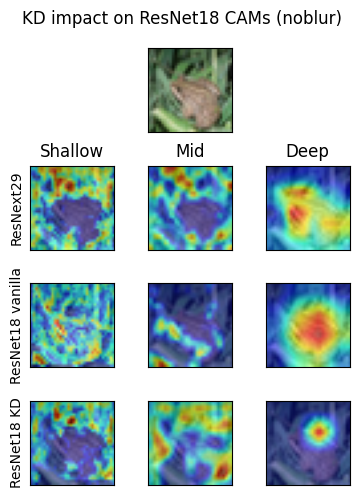

<Figure size 640x480 with 0 Axes>

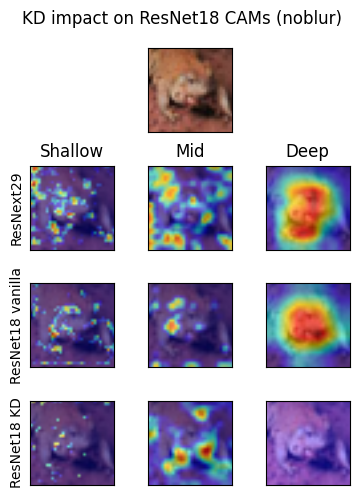

<Figure size 640x480 with 0 Axes>

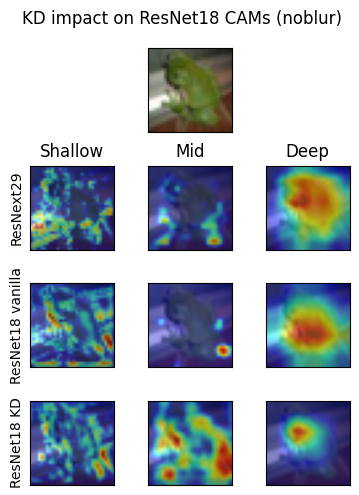

<Figure size 640x480 with 0 Axes>

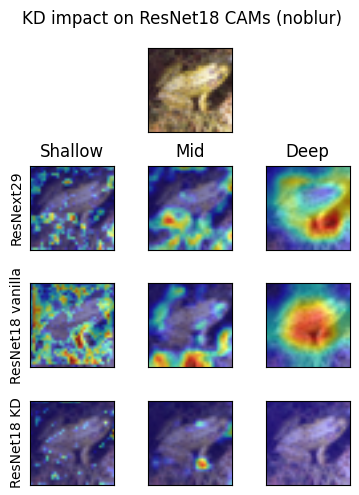

<Figure size 640x480 with 0 Axes>

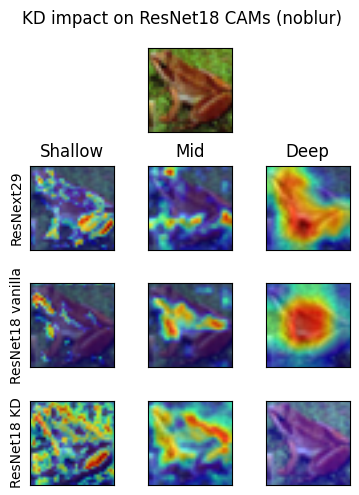

<Figure size 640x480 with 0 Axes>

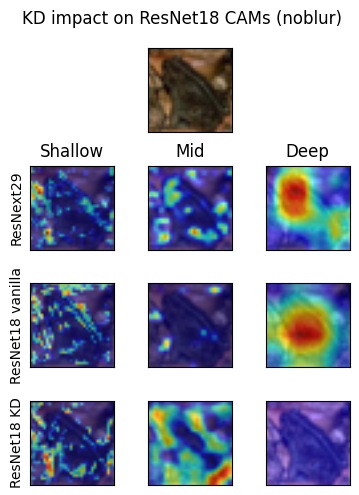

<Figure size 640x480 with 0 Axes>

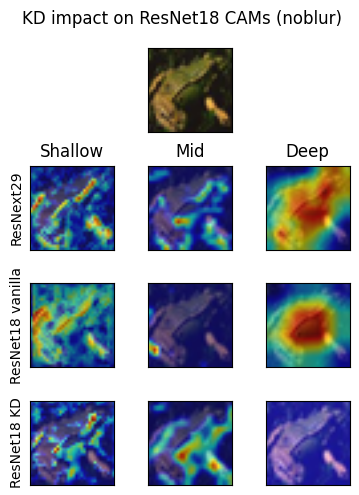

<Figure size 640x480 with 0 Axes>

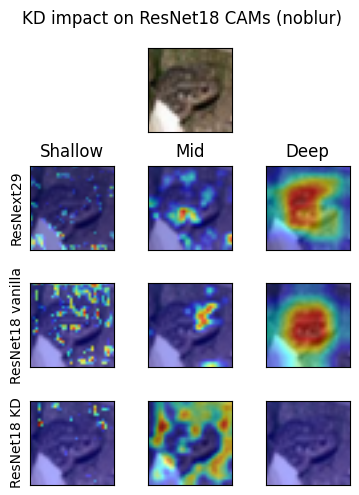

<Figure size 640x480 with 0 Axes>

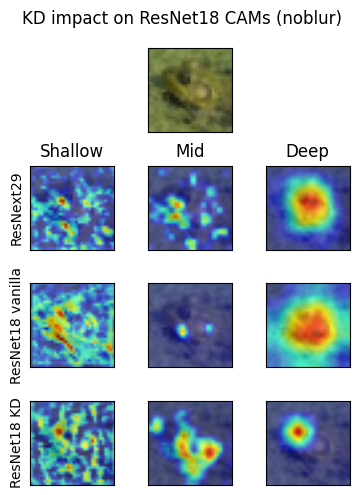

<Figure size 640x480 with 0 Axes>

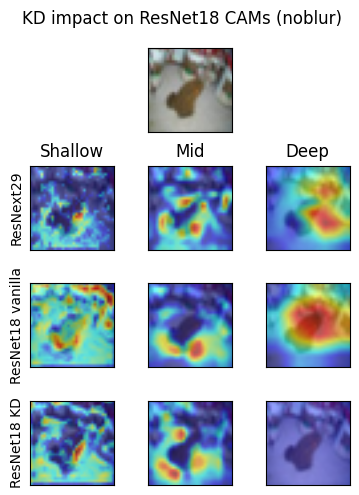

In [248]:
batch_heatmap_compare_KD_vanilla_noblur(raw_val_frogs, tensor_resnext29_val_frogvisual, tensor_resnet18_vanilla_noblur_val_frogvisual, tensor_resnet18KD_noblur_val_frogvisual,"ResNet18")

<Figure size 640x480 with 0 Axes>

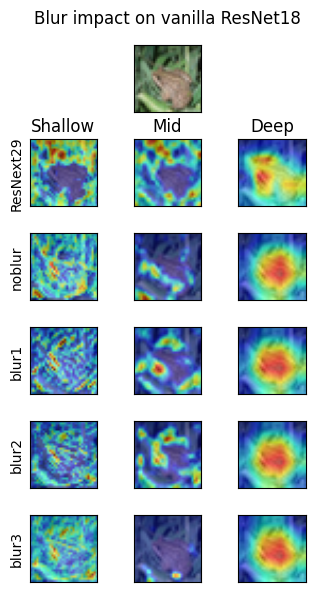

<Figure size 640x480 with 0 Axes>

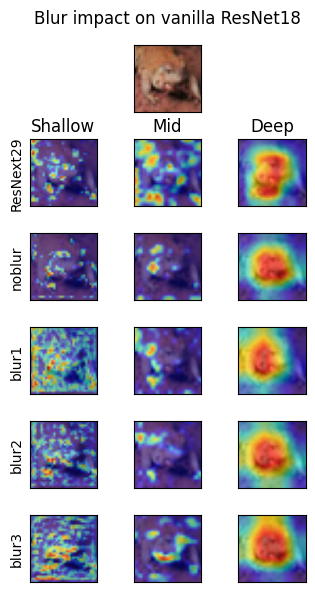

<Figure size 640x480 with 0 Axes>

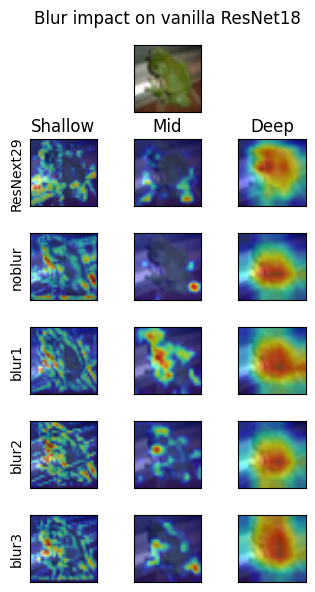

<Figure size 640x480 with 0 Axes>

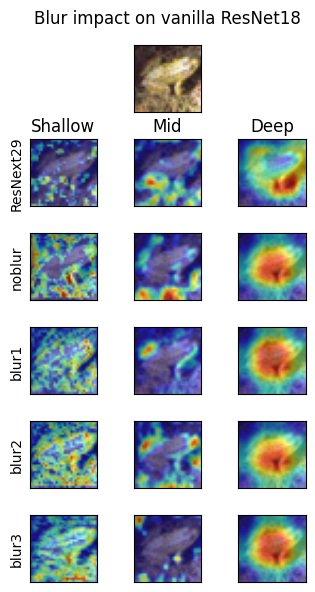

<Figure size 640x480 with 0 Axes>

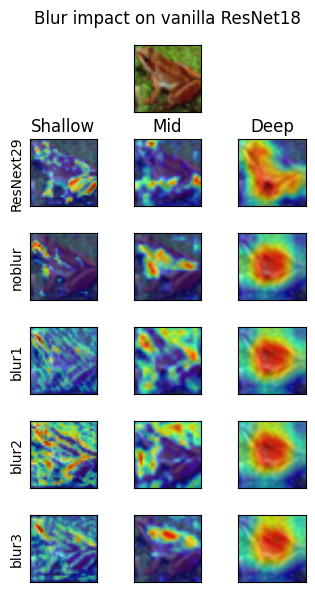

<Figure size 640x480 with 0 Axes>

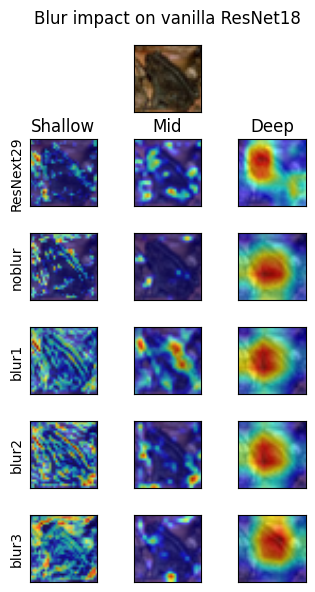

<Figure size 640x480 with 0 Axes>

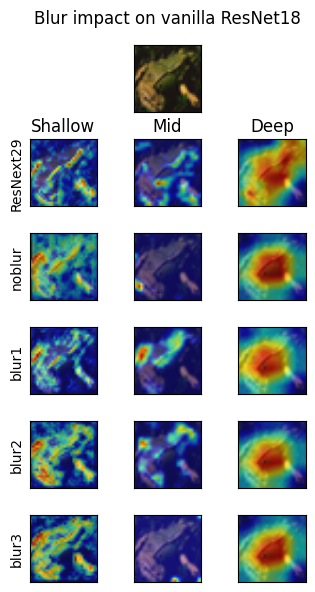

<Figure size 640x480 with 0 Axes>

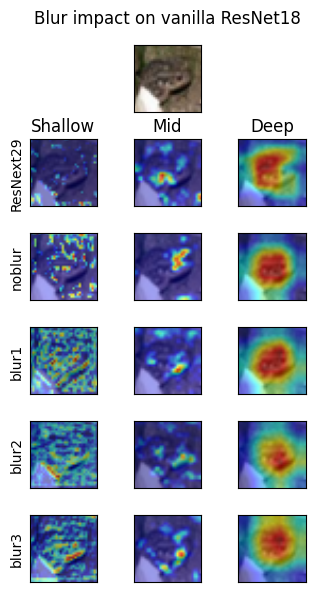

<Figure size 640x480 with 0 Axes>

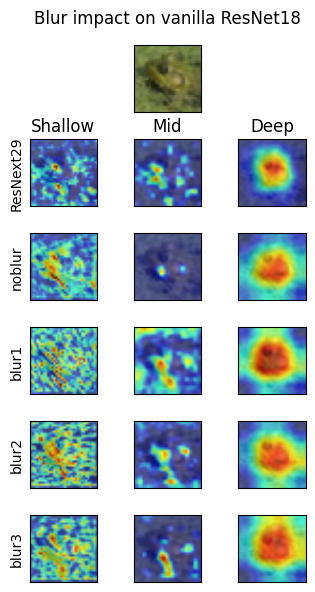

<Figure size 640x480 with 0 Axes>

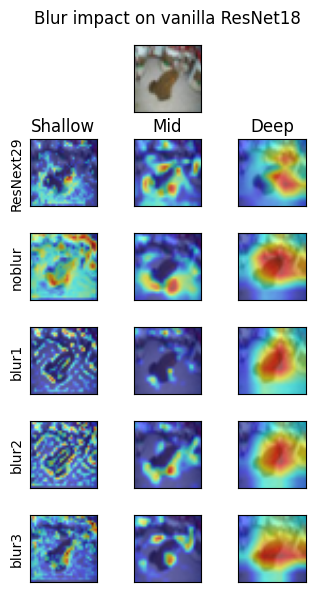

In [249]:
batch_heatmap_compare_vanilla_blur(raw_val_frogs, 
                                   tensor_resnext29_val_frogvisual,
                                   tensor_resnet18_vanilla_noblur_val_frogvisual,
                                   tensor_resnet18_vanillla_layer1_val_frogvisual, tensor_resnet18_vanillla_layer2_val_frogvisual, 
                                   tensor_resnet18_vanillla_layer3_val_frogvisual,"ResNet18")

<Figure size 640x480 with 0 Axes>

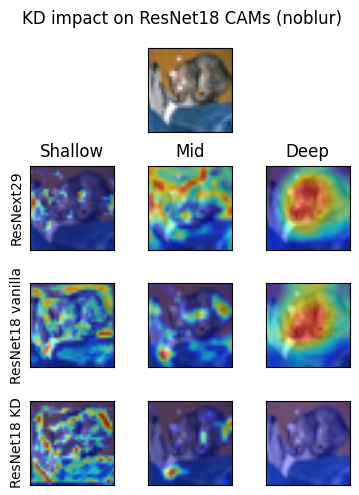

<Figure size 640x480 with 0 Axes>

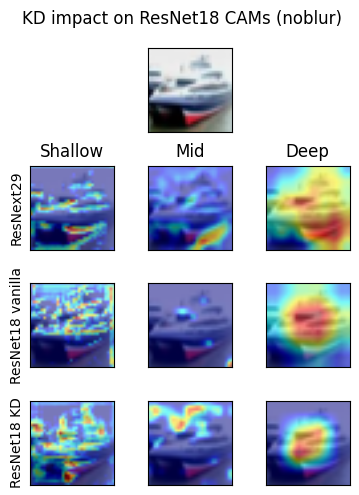

<Figure size 640x480 with 0 Axes>

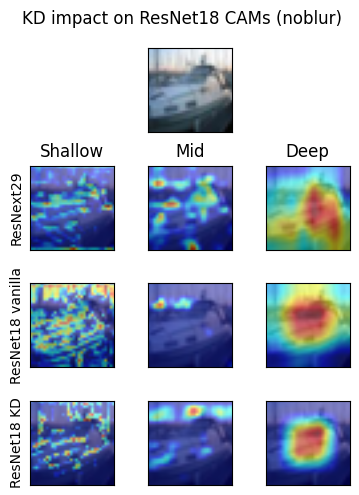

<Figure size 640x480 with 0 Axes>

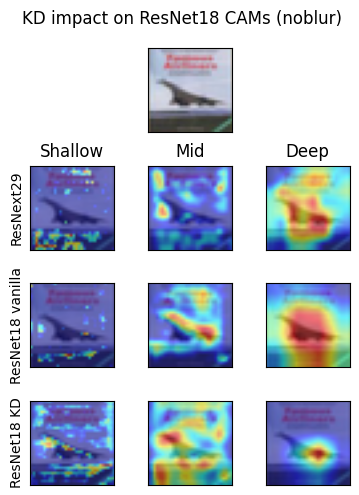

<Figure size 640x480 with 0 Axes>

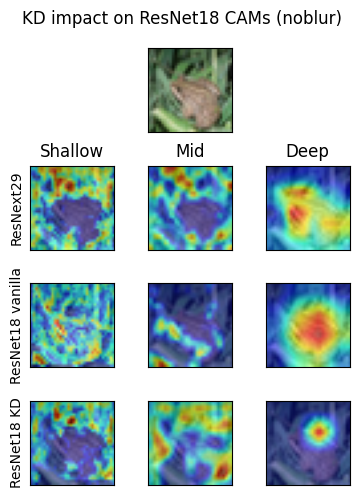

<Figure size 640x480 with 0 Axes>

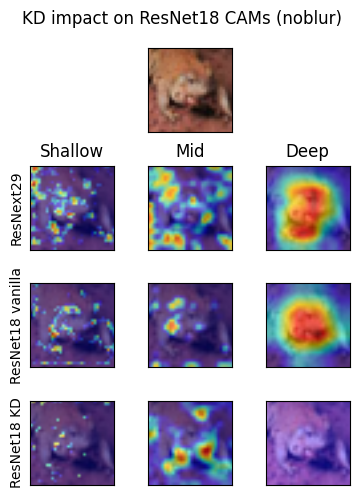

<Figure size 640x480 with 0 Axes>

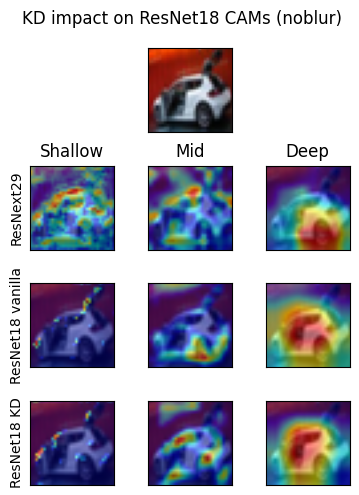

<Figure size 640x480 with 0 Axes>

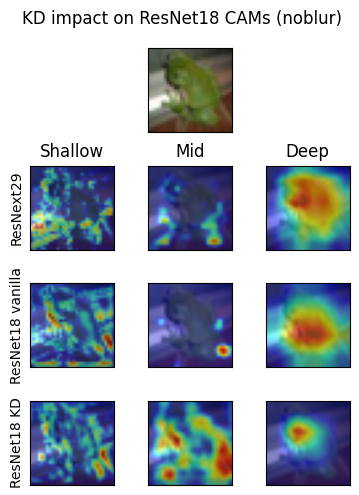

<Figure size 640x480 with 0 Axes>

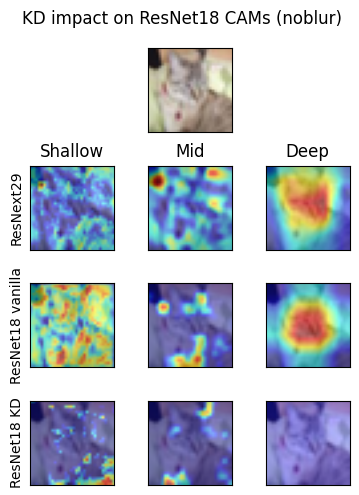

<Figure size 640x480 with 0 Axes>

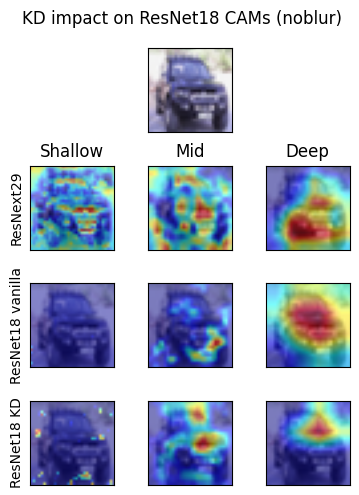

<Figure size 640x480 with 0 Axes>

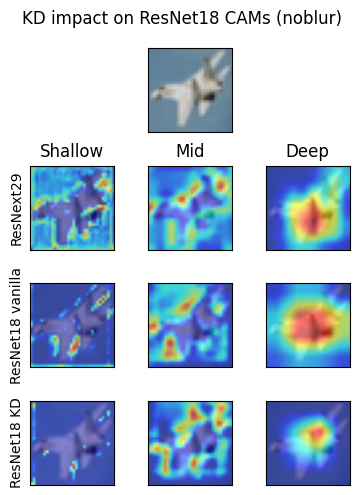

<Figure size 640x480 with 0 Axes>

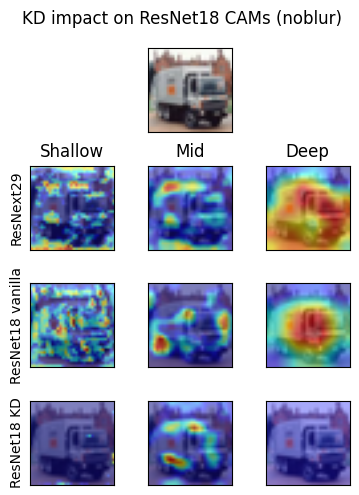

<Figure size 640x480 with 0 Axes>

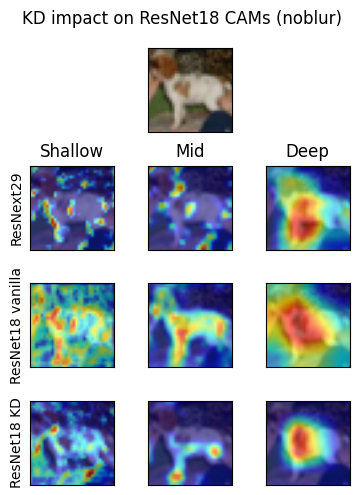

<Figure size 640x480 with 0 Axes>

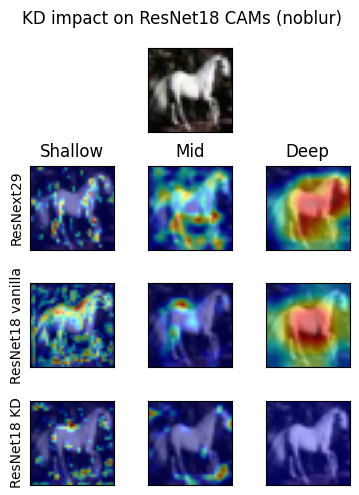

<Figure size 640x480 with 0 Axes>

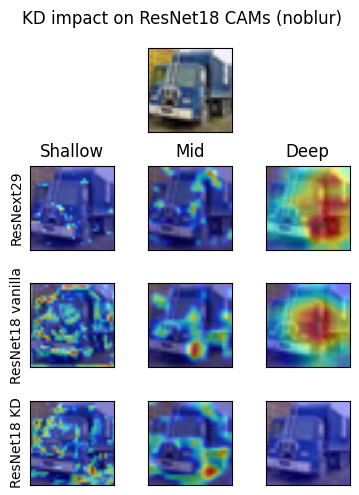

In [250]:
batch_heatmap_compare_KD_vanilla_noblur(raw_val_images, tensor_resnext29_val_visual, tensor_resnet18_vanilla_noblur_val_visual, tensor_resnet18KD_noblur_val_visual,"ResNet18")

<Figure size 640x480 with 0 Axes>

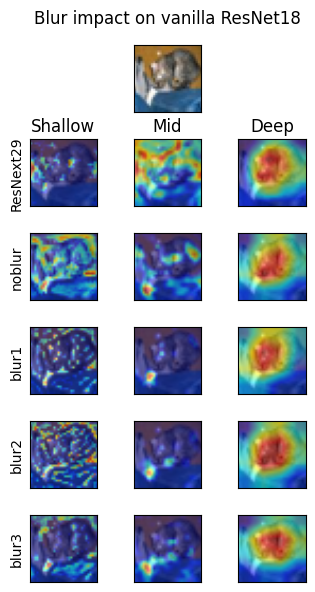

<Figure size 640x480 with 0 Axes>

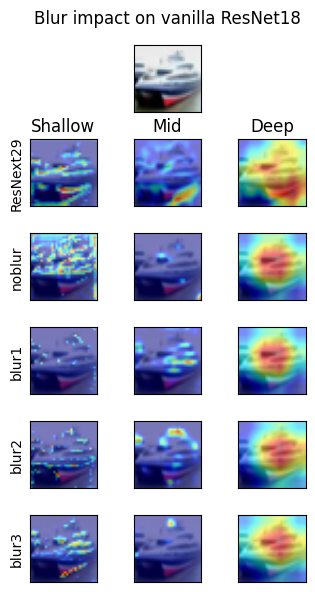

<Figure size 640x480 with 0 Axes>

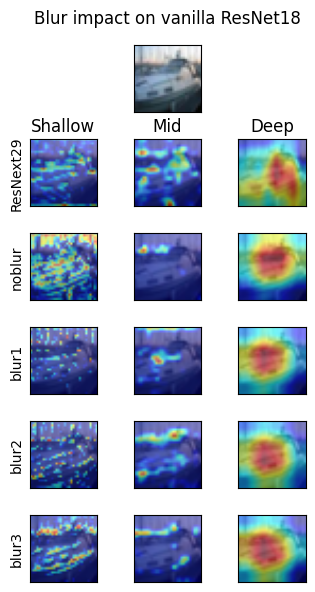

<Figure size 640x480 with 0 Axes>

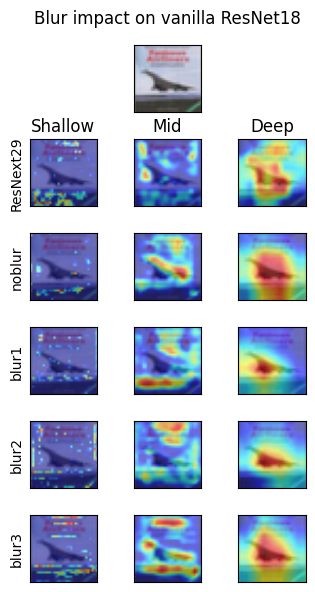

<Figure size 640x480 with 0 Axes>

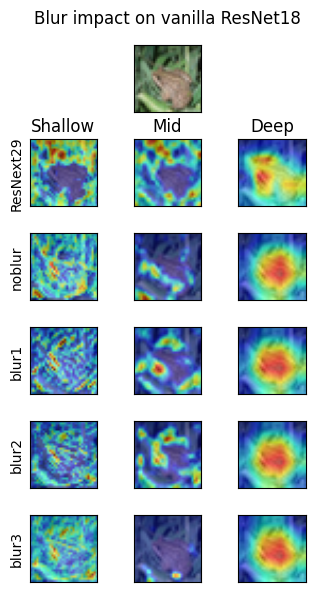

<Figure size 640x480 with 0 Axes>

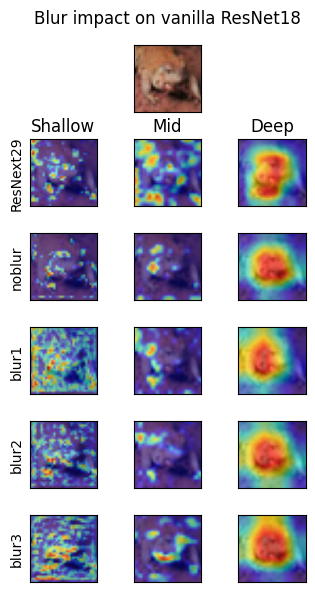

<Figure size 640x480 with 0 Axes>

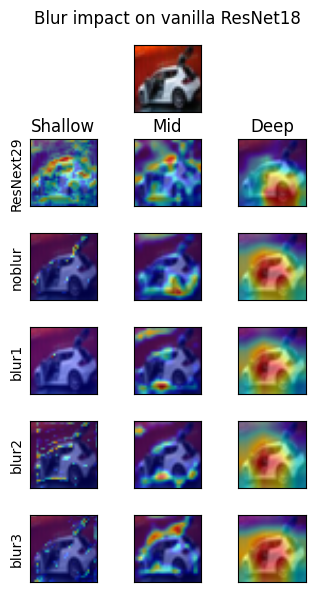

<Figure size 640x480 with 0 Axes>

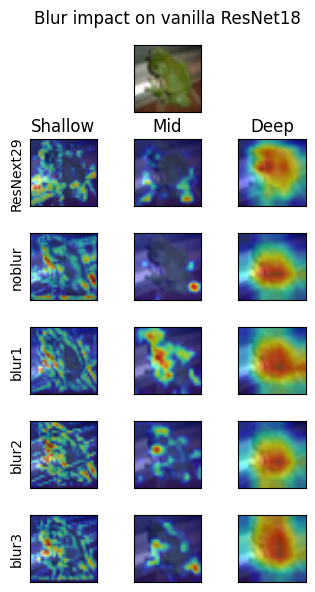

<Figure size 640x480 with 0 Axes>

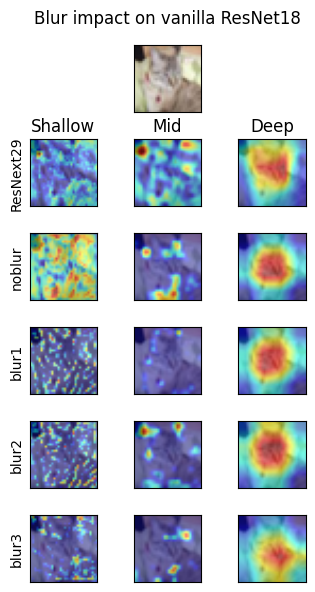

<Figure size 640x480 with 0 Axes>

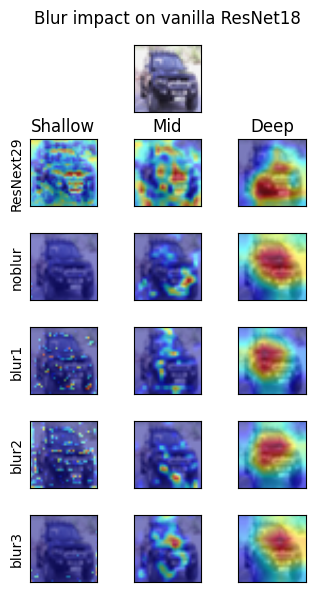

<Figure size 640x480 with 0 Axes>

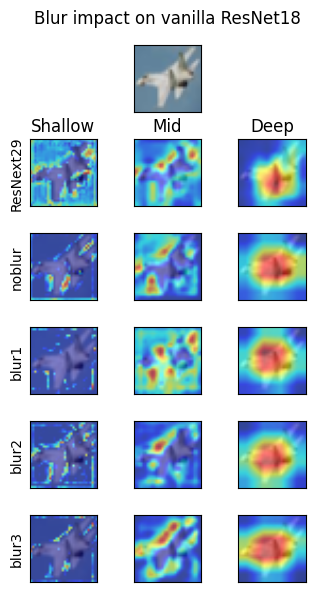

<Figure size 640x480 with 0 Axes>

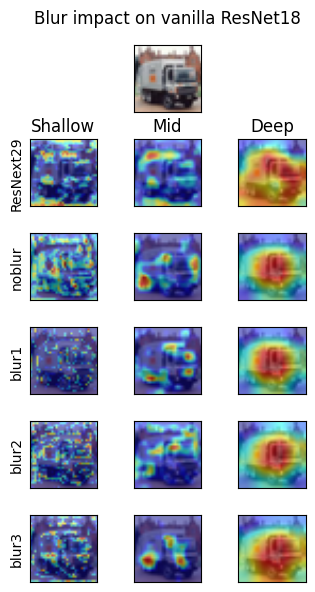

<Figure size 640x480 with 0 Axes>

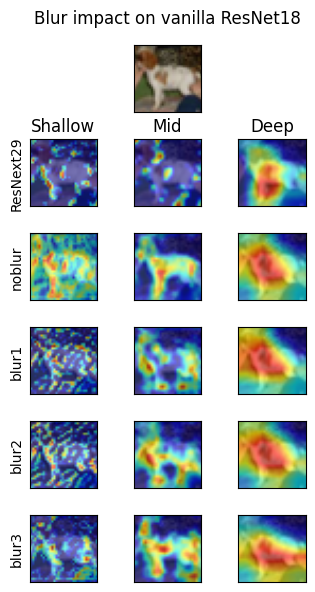

<Figure size 640x480 with 0 Axes>

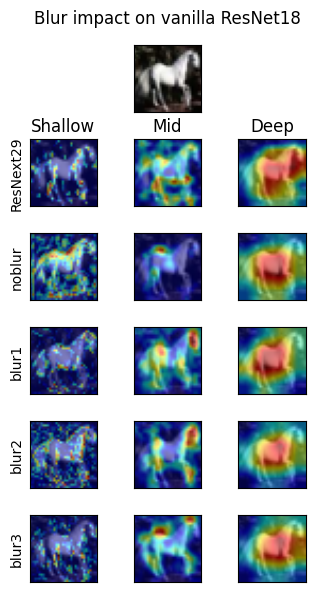

<Figure size 640x480 with 0 Axes>

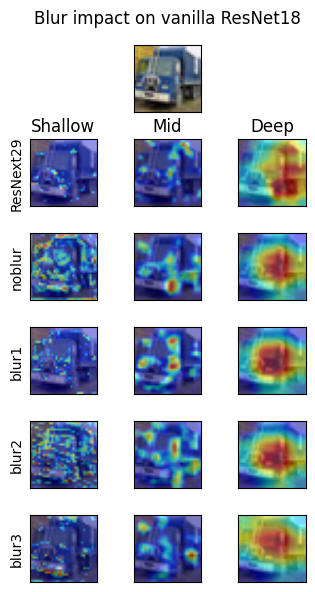

In [251]:
batch_heatmap_compare_vanilla_blur(raw_val_images, tensor_resnext29_val_visual,
                                   tensor_resnet18_vanilla_noblur_val_visual,
                                   tensor_resnet18_vanillla_layer1_val_visual,
                                   tensor_resnet18_vanillla_layer2_val_visual, tensor_resnet18_vanillla_layer3_val_visual,"ResNet18")

<Figure size 640x480 with 0 Axes>

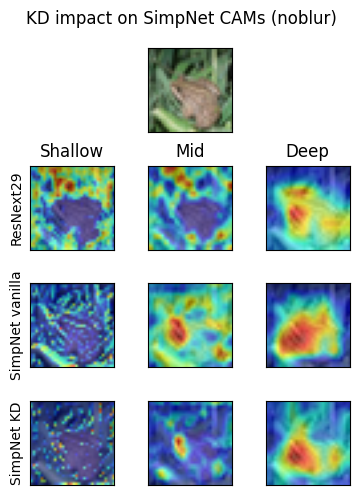

<Figure size 640x480 with 0 Axes>

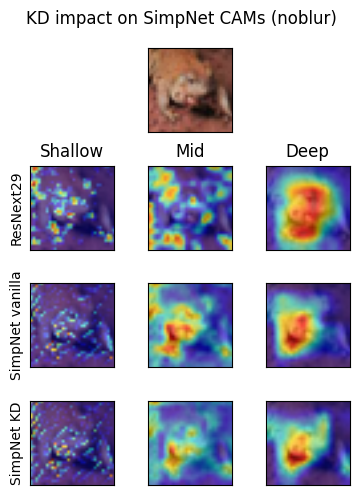

<Figure size 640x480 with 0 Axes>

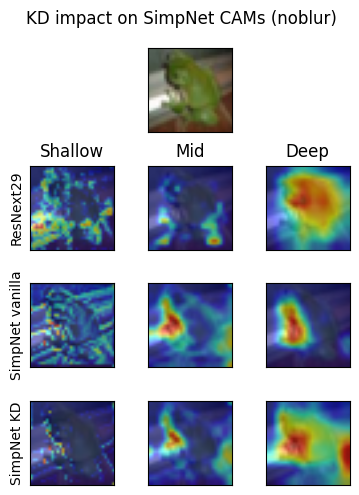

<Figure size 640x480 with 0 Axes>

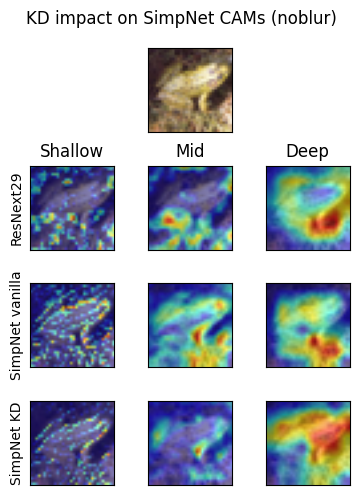

<Figure size 640x480 with 0 Axes>

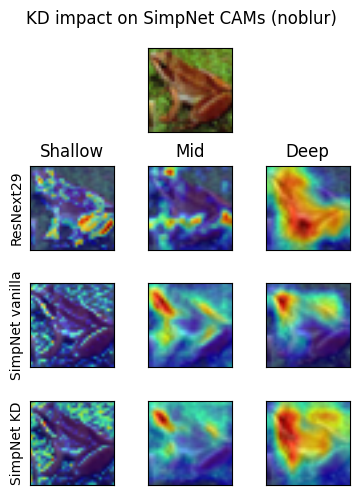

<Figure size 640x480 with 0 Axes>

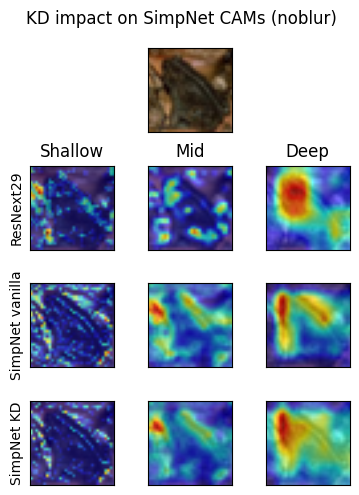

<Figure size 640x480 with 0 Axes>

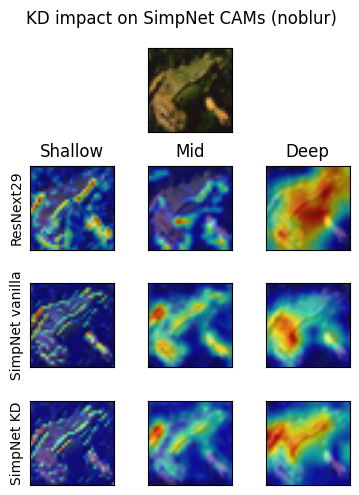

<Figure size 640x480 with 0 Axes>

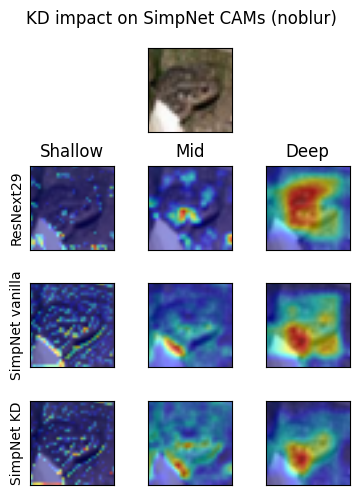

<Figure size 640x480 with 0 Axes>

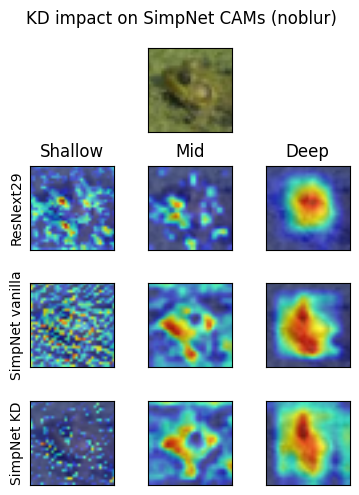

<Figure size 640x480 with 0 Axes>

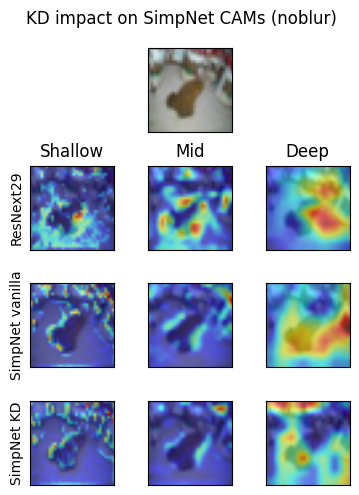

In [252]:
batch_heatmap_compare_KD_vanilla_noblur(raw_val_frogs, tensor_resnext29_val_frogvisual, tensor_simpnet_vanilla_noblur_val_frogvisual, tensor_simpnetKD_noblur_val_frogvisual,"SimpNet")

<Figure size 640x480 with 0 Axes>

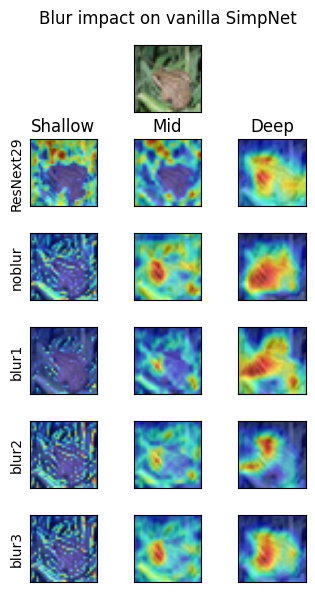

<Figure size 640x480 with 0 Axes>

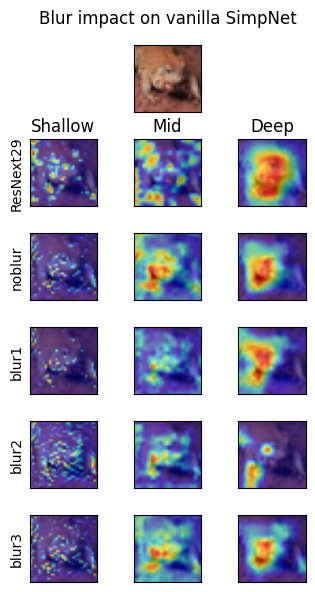

<Figure size 640x480 with 0 Axes>

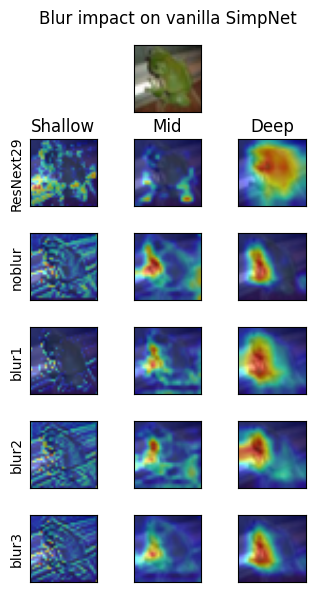

<Figure size 640x480 with 0 Axes>

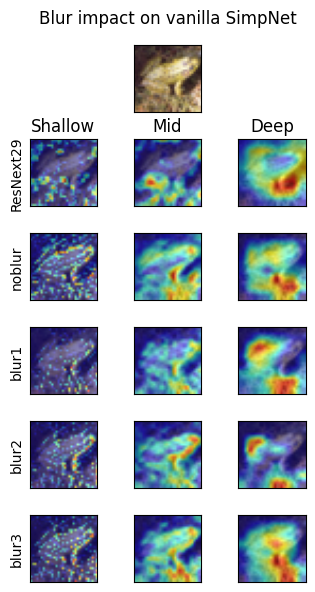

<Figure size 640x480 with 0 Axes>

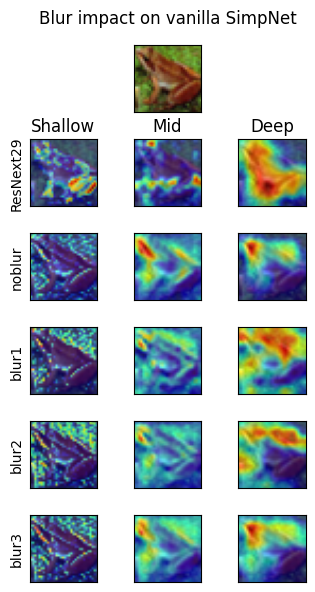

<Figure size 640x480 with 0 Axes>

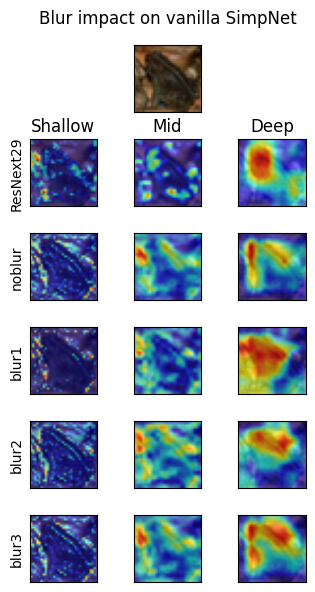

<Figure size 640x480 with 0 Axes>

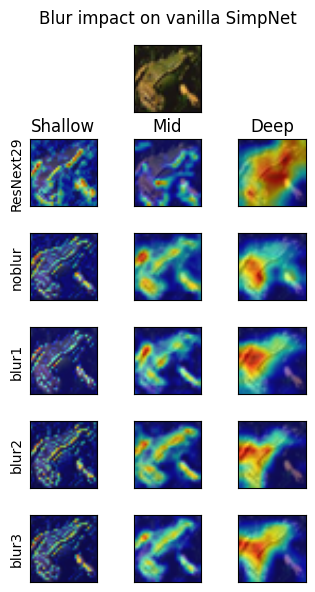

<Figure size 640x480 with 0 Axes>

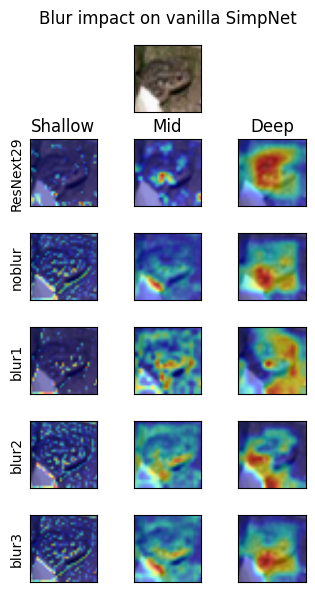

<Figure size 640x480 with 0 Axes>

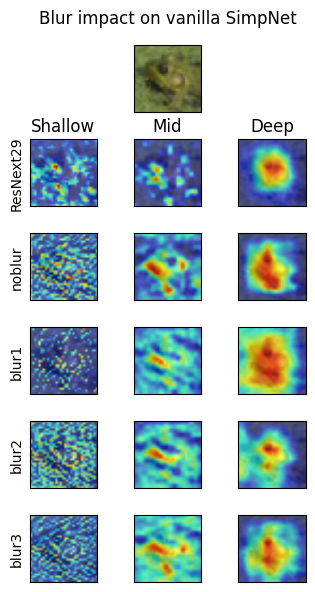

<Figure size 640x480 with 0 Axes>

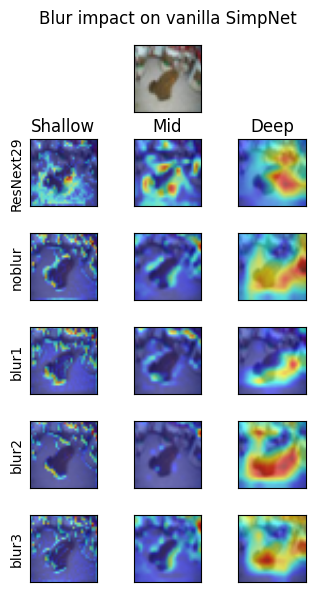

In [253]:
batch_heatmap_compare_vanilla_blur(raw_val_frogs, tensor_resnext29_val_frogvisual,
                                   tensor_simpnet_vanilla_noblur_val_frogvisual,
                                   tensor_simpnet_vanillla_layer1_val_frogvisual, tensor_simpnet_vanillla_layer2_val_frogvisual, tensor_simpnet_vanillla_layer3_val_frogvisual,"SimpNet")

<Figure size 640x480 with 0 Axes>

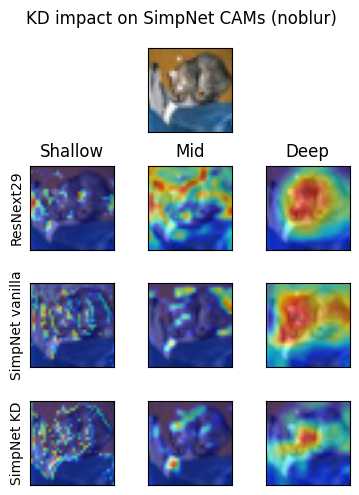

<Figure size 640x480 with 0 Axes>

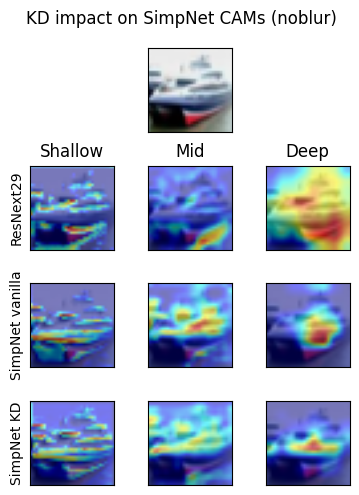

<Figure size 640x480 with 0 Axes>

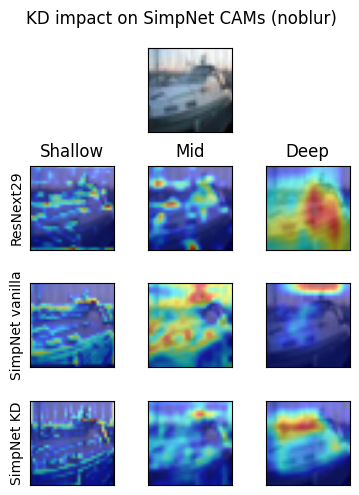

<Figure size 640x480 with 0 Axes>

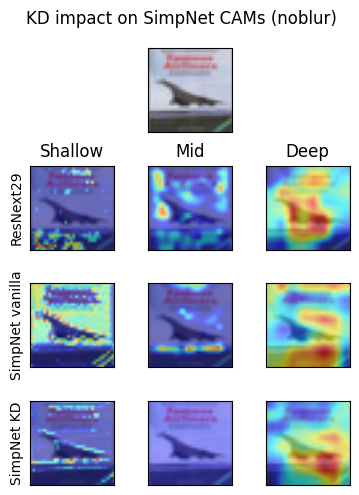

<Figure size 640x480 with 0 Axes>

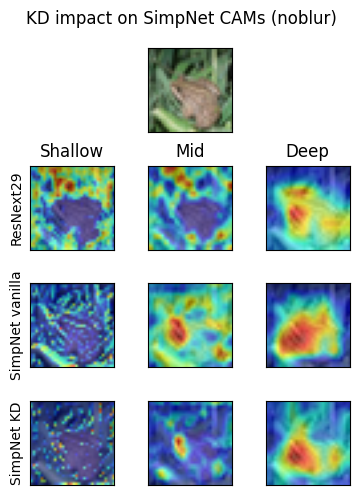

<Figure size 640x480 with 0 Axes>

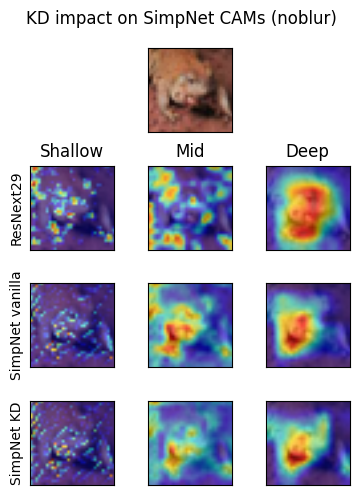

<Figure size 640x480 with 0 Axes>

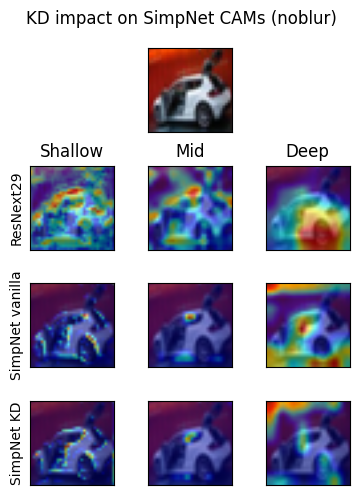

<Figure size 640x480 with 0 Axes>

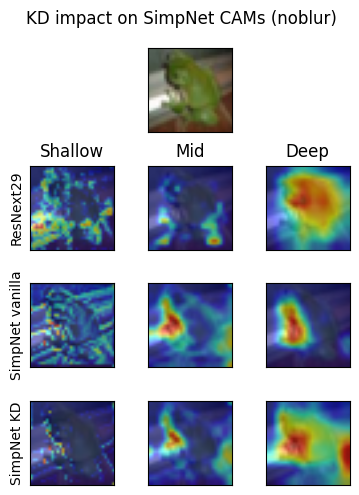

<Figure size 640x480 with 0 Axes>

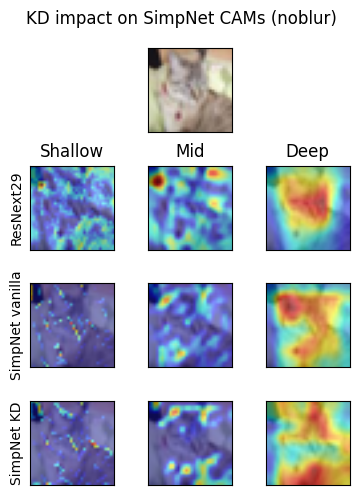

<Figure size 640x480 with 0 Axes>

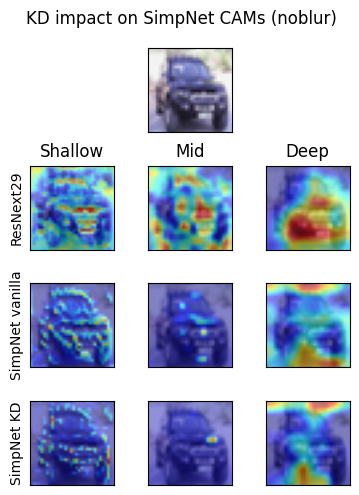

<Figure size 640x480 with 0 Axes>

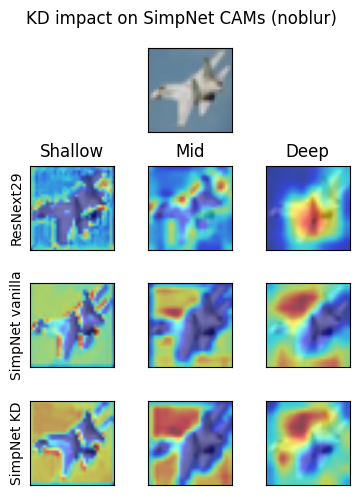

<Figure size 640x480 with 0 Axes>

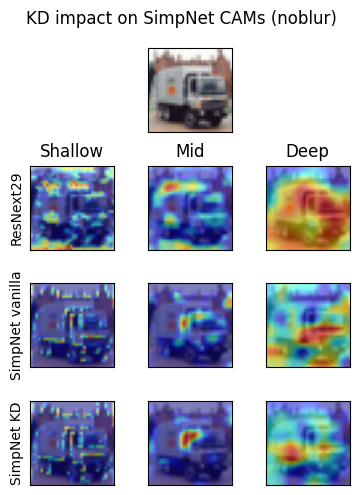

<Figure size 640x480 with 0 Axes>

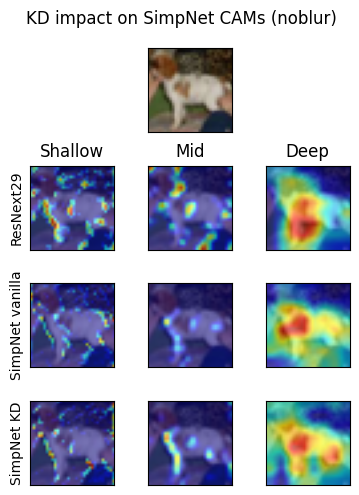

<Figure size 640x480 with 0 Axes>

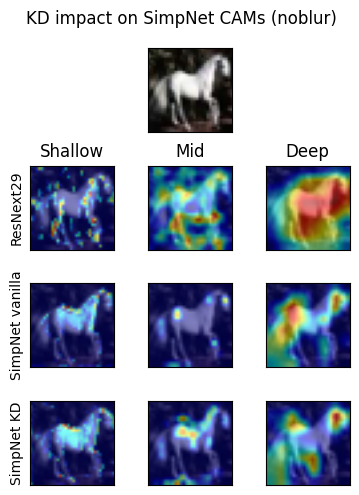

<Figure size 640x480 with 0 Axes>

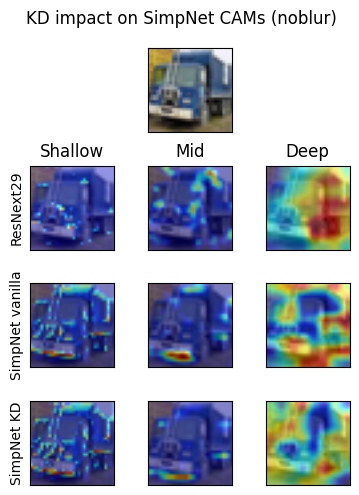

In [254]:
batch_heatmap_compare_KD_vanilla_noblur(raw_val_images, tensor_resnext29_val_visual, tensor_simpnet_vanilla_noblur_val_visual, tensor_simpnetKD_noblur_val_visual,"SimpNet")

<Figure size 640x480 with 0 Axes>

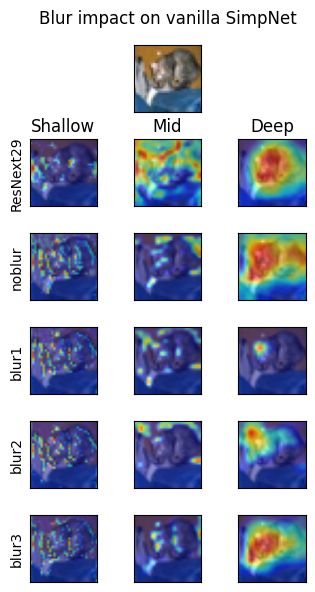

<Figure size 640x480 with 0 Axes>

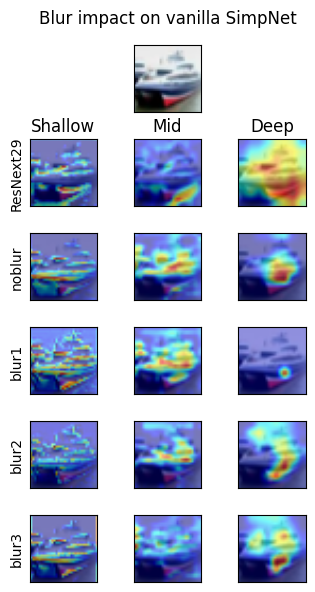

<Figure size 640x480 with 0 Axes>

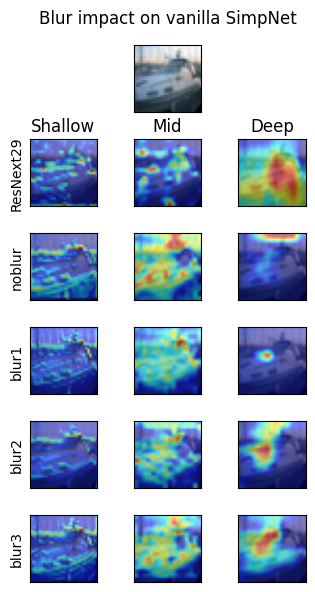

<Figure size 640x480 with 0 Axes>

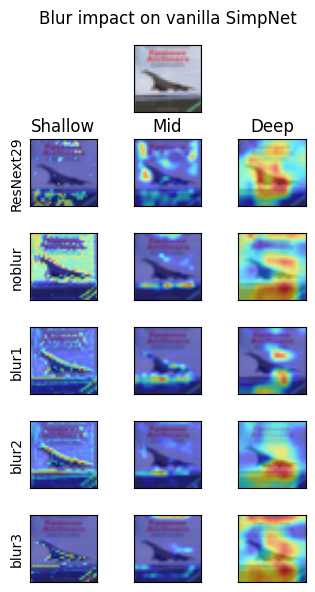

<Figure size 640x480 with 0 Axes>

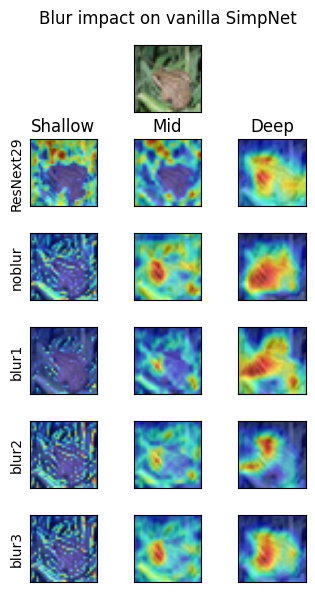

<Figure size 640x480 with 0 Axes>

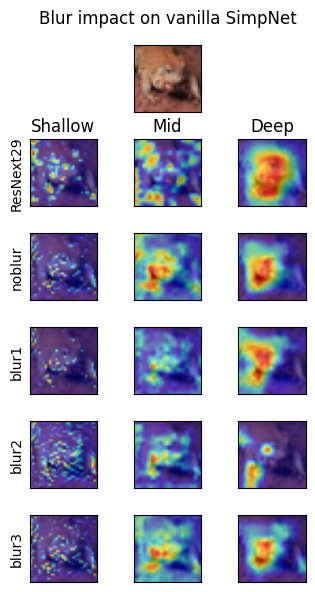

<Figure size 640x480 with 0 Axes>

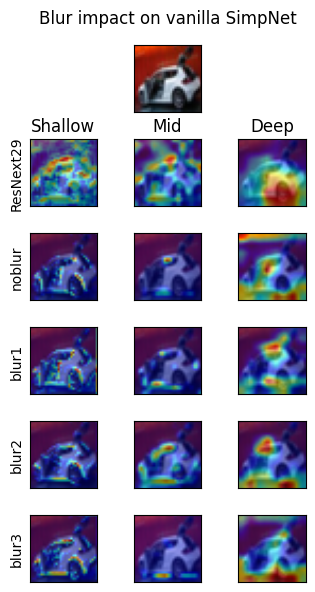

<Figure size 640x480 with 0 Axes>

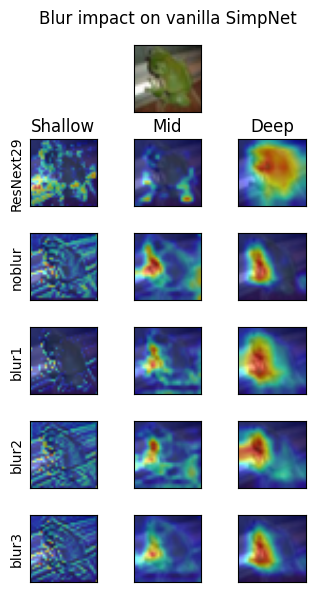

<Figure size 640x480 with 0 Axes>

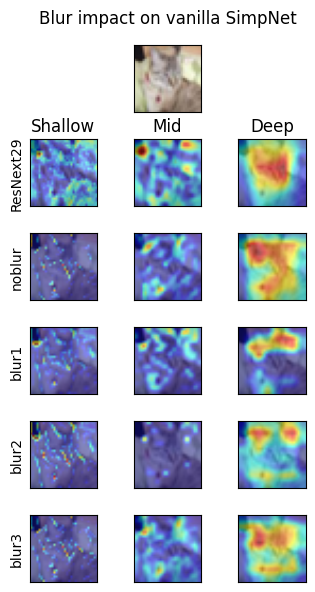

<Figure size 640x480 with 0 Axes>

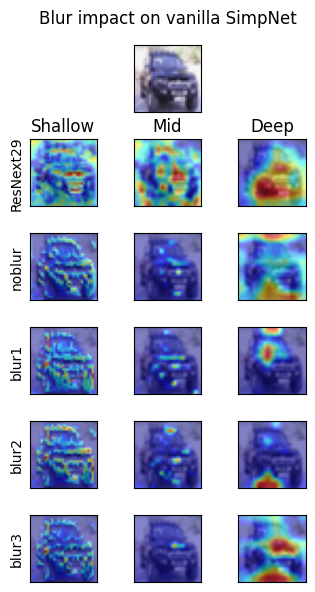

<Figure size 640x480 with 0 Axes>

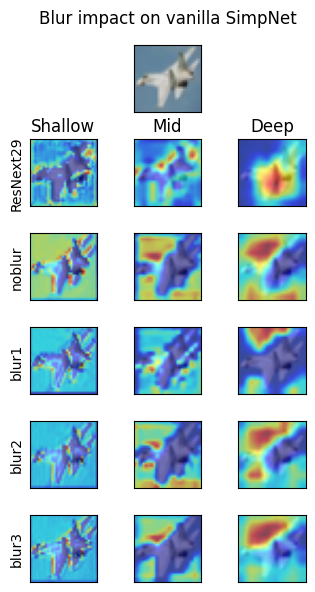

<Figure size 640x480 with 0 Axes>

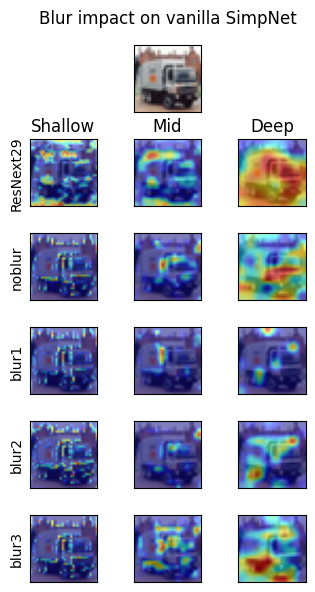

<Figure size 640x480 with 0 Axes>

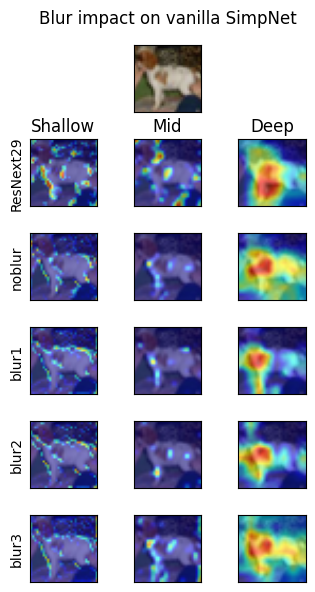

<Figure size 640x480 with 0 Axes>

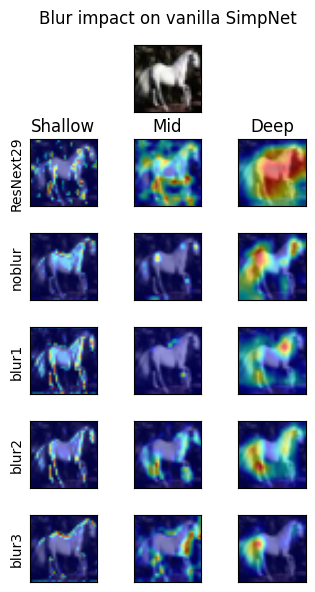

<Figure size 640x480 with 0 Axes>

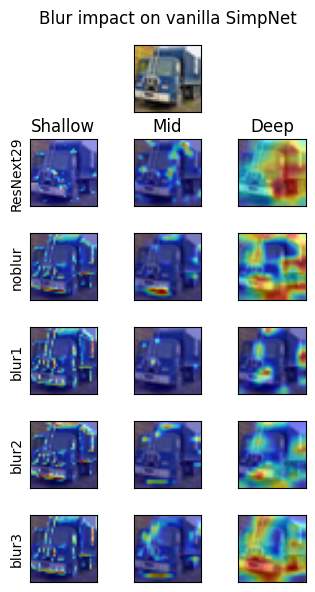

In [255]:
batch_heatmap_compare_vanilla_blur(raw_val_images, tensor_resnext29_val_visual,
                                   tensor_simpnet_vanilla_noblur_val_visual,
                                   tensor_simpnet_vanillla_layer1_val_visual, tensor_simpnet_vanillla_layer2_val_visual, tensor_simpnet_vanillla_layer3_val_visual,"SimpNet")

In [256]:
batch_heatmap_compare(raw_val_images, tensor_resnext29_val_visual, tensor_simpnet_vanilla_noblur_val_visual, tensor_simpnetKD_noblur_val_visual)

NameError: name 'batch_heatmap_compare' is not defined

NameError: name 'tensor_simpnet_vanilla_noblur_train_visual' is not defined

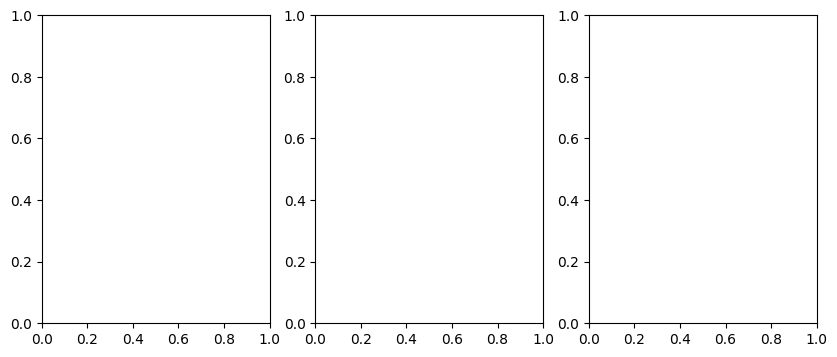

In [ ]:


# Create a figure and axis
fig, axs = plt.subplots(1, 3, figsize=(10, 4))
for i in range(3):
# Plot each image
   # axs[i].imshow(image1)
    axs[i].imshow(tensor_simpnet_vanilla_noblur_train_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[i].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

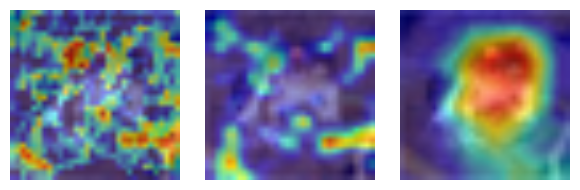

In [ ]:


# Create a figure and axis
fig, axs = plt.subplots(1, 3, figsize=(6, 2))
for i in range(3):
# Plot each image
   # axs[i].imshow(image1)
    axs[i].imshow(tensor_resnext29_train_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[i].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

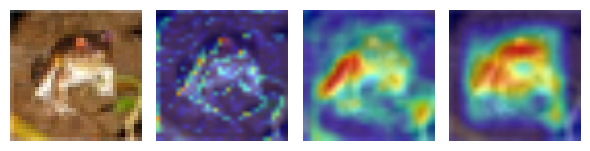

In [ ]:

# Create a figure and axis
fig, axs = plt.subplots(1, 4, figsize=(6, 2))
axs[0].imshow(np.array(trainimg1))
axs[0].axis('off')
for i in range(1,4):
# Plot each image
   # axs[i].imshow(image1)
    axs[i].imshow(tensor_simpnet_vanilla_noblur_train_visual[0][i-1].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[i].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

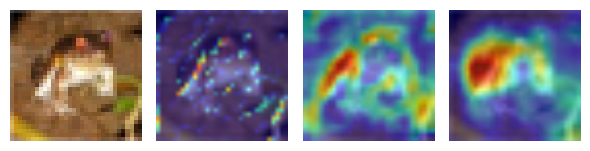

In [ ]:

# Create a figure and axis
fig, axs = plt.subplots(1, 4, figsize=(6, 2))
axs[0].imshow(np.array(trainimg1))
axs[0].axis('off')
for i in range(1,4):
# Plot each image
   # axs[i].imshow(image1)
    axs[i].imshow(tensor_simpnetKD_noblur_train_visual[0][i-1].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[i].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

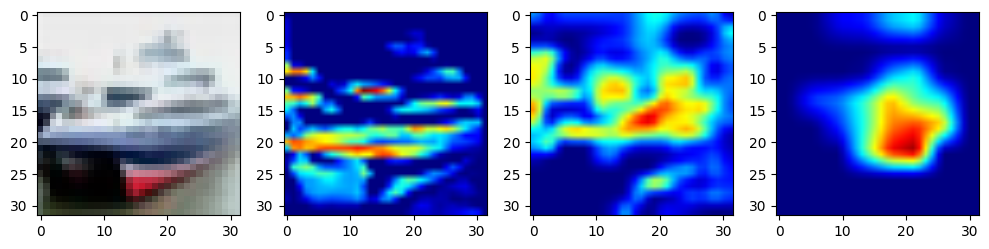

In [ ]:


# Create a figure and axis
fig, axs = plt.subplots(1, 4, figsize=(10, 5))

axs[0].imshow(np.array(valimg2))
axs[1].imshow(simpnet_vanilla_noblur_val_visual[1][0].astype(int).transpose(1, 2, 0), interpolation='bilinear')
axs[2].imshow(simpnet_vanilla_noblur_val_visual[1][1].astype(int).transpose(1, 2, 0), interpolation='bilinear')
axs[3].imshow(simpnet_vanilla_noblur_val_visual[1][2].astype(int).transpose(1, 2, 0), interpolation='bilinear')
#for i in range(3):
# Plot each image
   # axs[i].imshow(image1)
  #$#  axs[i].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

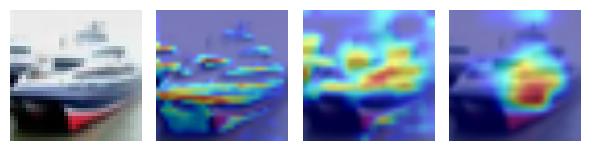

In [ ]:

# Create a figure and axis
fig, axs = plt.subplots(1, 4, figsize=(6, 2))
axs[0].imshow(np.array(valimg2))
axs[0].axis('off')
for i in range(1,4):
# Plot each image
   # axs[i].imshow(image1)
    axs[i].imshow(tensor_simpnet_vanilla_noblur_val_visual[1][i-1].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[i].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

In [ ]:
teacher_layer_strings= [
                      
                             "stg1 BNK3",
              
                             "stg2 BNK3",
                      
                             "stg3 BNK3"]


simpnet_layer_strings= ["conv1", "conv2", "conv3"]

In [ ]:
tensor_resnext29_train_visual.shape

(10, 3, 3, 32, 32)

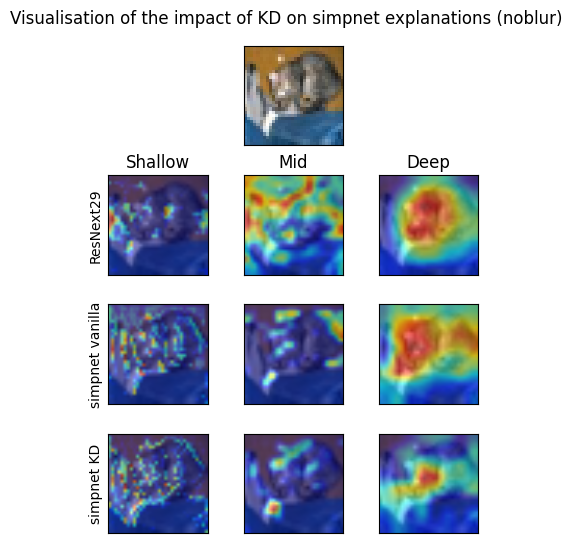

In [ ]:
# Create a figure and axis
fig, axs = plt.subplots(4, 3, figsize=(4.5,5.5))
original = np.array(raw_val_images[0]) 

for i in range(3):
# Plot each image
   # axs[i].imshow(image1)
    axs[1][i].imshow(tensor_resnext29_val_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[2][i].imshow(tensor_simpnet_vanilla_noblur_val_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[3][i].imshow(tensor_simpnetKD_noblur_val_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
   # axs[i].axis('off')
   #axs[x+1][i].set_title(f"ker{kernels[x]},sig{sigmas[i]}")
for ax in axs.ravel():
   #ax.axis('off')    
   ax.set_yticklabels([])
   ax.set_xticklabels([])
   ax.set_xticks([])
   ax.set_yticks([])
   
rows = ["Original", "ResNext29", "simpnet vanilla", "simpnet KD"]   
for ax, row in zip(axs[:,0], rows):
    ax.set_ylabel(row, rotation=90, size='medium')
axs[0][1].imshow(original)
fig.delaxes(axs[0][0])
fig.delaxes(axs[0][2])

axs[1][0].set_title("Shallow")
axs[1][1].set_title("Mid")
axs[1][2].set_title("Deep")




#
fig.suptitle("Visualisation of the impact of KD on simpnet explanations (noblur)")
# Adjust layout and show the plot
plt.tight_layout()
plt.subplots_adjust(wspace =0, hspace = 0.3
                    )
plt.show()

<Figure size 640x480 with 0 Axes>

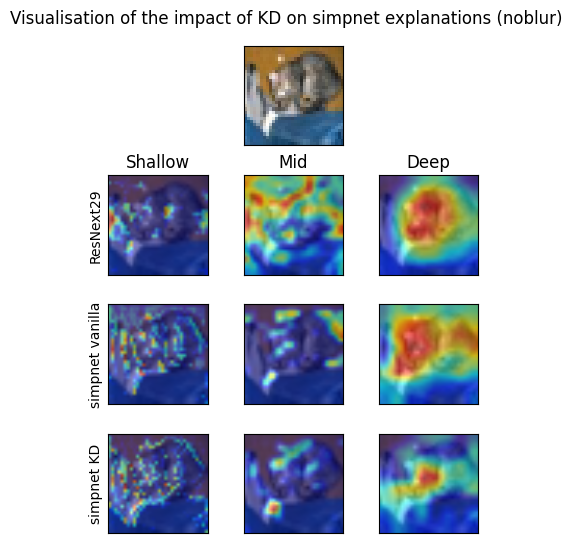

<Figure size 640x480 with 0 Axes>

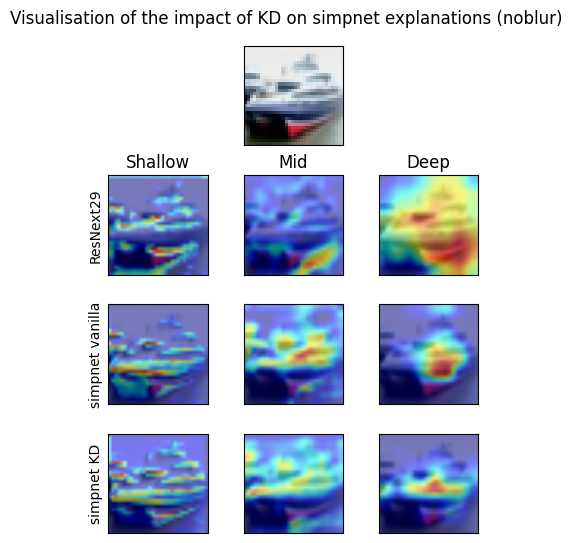

<Figure size 640x480 with 0 Axes>

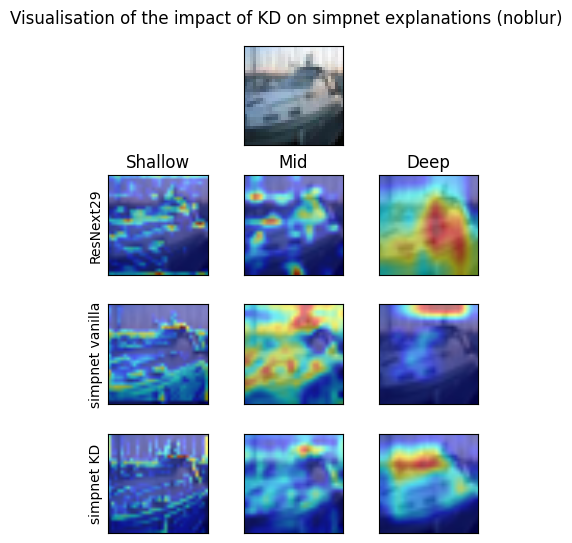

<Figure size 640x480 with 0 Axes>

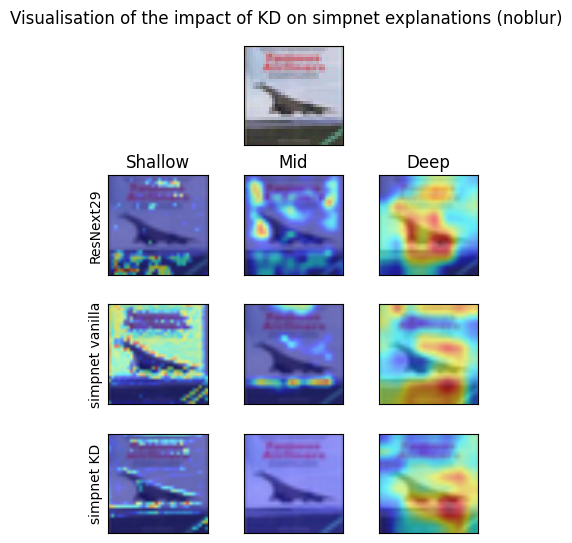

<Figure size 640x480 with 0 Axes>

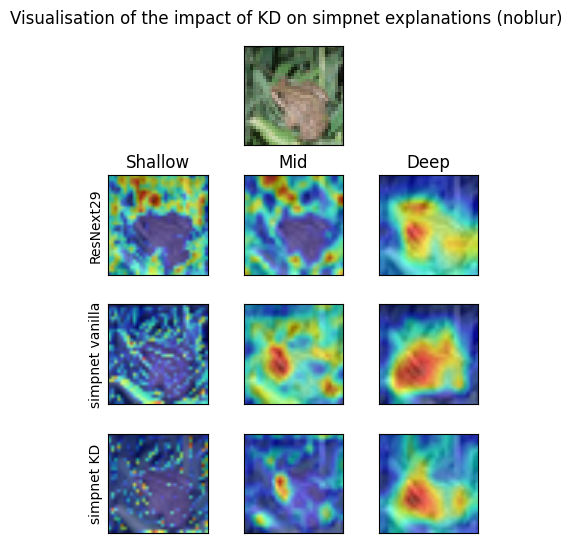

<Figure size 640x480 with 0 Axes>

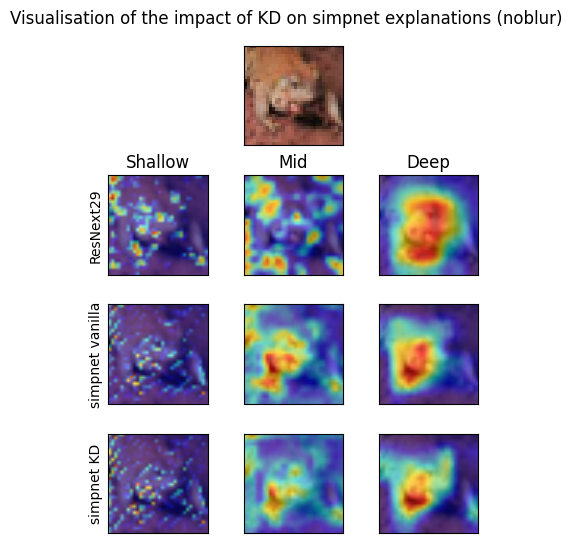

<Figure size 640x480 with 0 Axes>

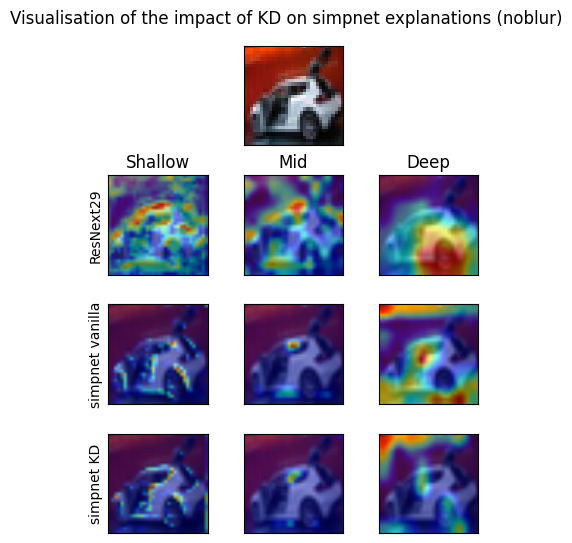

<Figure size 640x480 with 0 Axes>

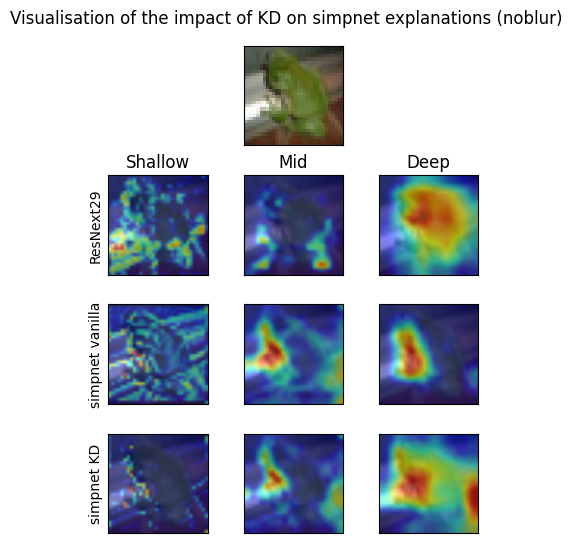

<Figure size 640x480 with 0 Axes>

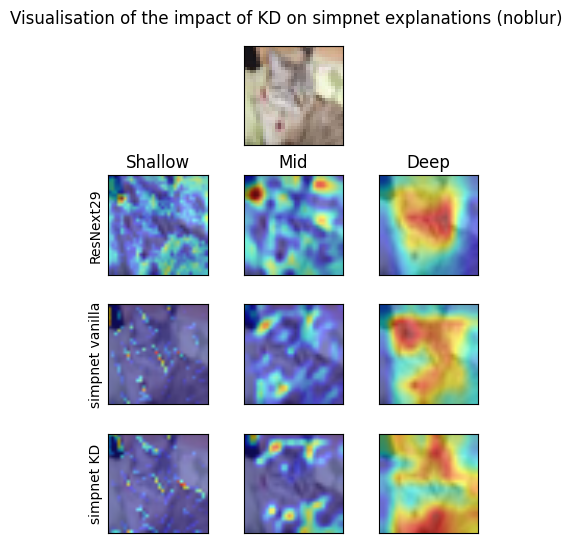

<Figure size 640x480 with 0 Axes>

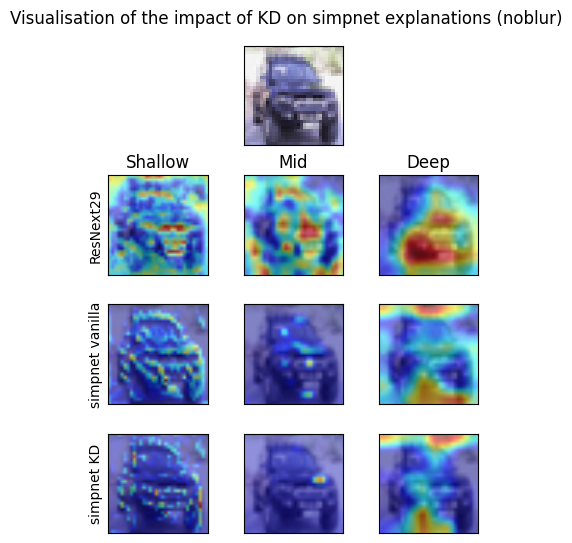

In [ ]:
batch_heatmap_compare(raw_val_images, tensor_resnext29_val_visual, tensor_simpnet_vanilla_noblur_val_visual, tensor_simpnetKD_noblur_val_visual)

In [ ]:
tensor_trainstack =  torch.stack([tensor_trainimg1, tensor_trainimg2], dim=0)
tensor_valstack =  torch.stack([tensor_valimg1, tensor_valimg2], dim=0)

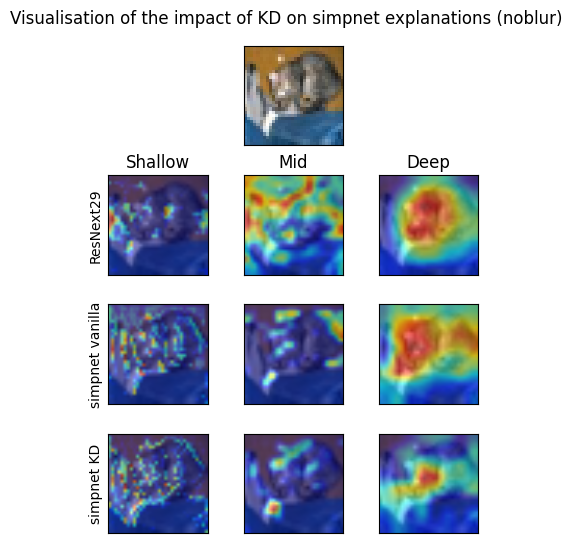

In [ ]:
# Create a figure and axis
fig, axs = plt.subplots(4, 3, figsize=(4.5,5.5))
original = np.array(valimg1) 

for i in range(3):
# Plot each image
   # axs[i].imshow(image1)
    axs[1][i].imshow(tensor_resnext29_val_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[2][i].imshow(tensor_simpnet_vanilla_noblur_val_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
    axs[3][i].imshow(tensor_simpnetKD_noblur_val_visual[0][i].astype(int).transpose(1, 2, 0), interpolation='bilinear')
   # axs[i].axis('off')
   #axs[x+1][i].set_title(f"ker{kernels[x]},sig{sigmas[i]}")
for ax in axs.ravel():
   #ax.axis('off')    
   ax.set_yticklabels([])
   ax.set_xticklabels([])
   ax.set_xticks([])
   ax.set_yticks([])
   
rows = ["Original", "ResNext29", "simpnet vanilla", "simpnet KD"]   
for ax, row in zip(axs[:,0], rows):
    ax.set_ylabel(row, rotation=90, size='medium')
axs[0][1].imshow(original)
fig.delaxes(axs[0][0])
fig.delaxes(axs[0][2])

axs[1][0].set_title("Shallow")
axs[1][1].set_title("Mid")
axs[1][2].set_title("Deep")




#
fig.suptitle("Visualisation of the impact of KD on simpnet explanations (noblur)")
# Adjust layout and show the plot
plt.tight_layout()
plt.subplots_adjust(wspace =0, hspace = 0.3
                    )
plt.show()

In [ ]:
visual_heatmap_compare(simpnetKD_noblur, teacher_model, val_dl, params)

length of list of student layers
3
length of list of teacher layers
3
shape of images tensor (batch of input samples))
torch.Size([5, 3, 32, 32])
student_heatmap_stack.shape
(3, 5, 32, 32)
teacher_heatmap_stack.shape
(3, 5, 32, 32)
studentcam shape
(5, 3, 32, 32)
teachercam shape
(5, 3, 32, 32)
Data type of studentcam: float32
studentcam (shape (5, 3, 32, 32), dtype float32), images (shape torch.Size([5, 3, 32, 32]), dtype torch.float32)
shape of hetmap matrix (5, 3, 32, 32)
shape of overlay matrix: (5, 3, 3, 32, 32)
the images given are tensors
successfully converted to numpy arrays
shape of current heatmap: (32, 32)
current heatmap datatype: float32
shape of current image: (3, 32, 32)
current image datatype: float32
current image: [[[ 0.5190602   0.53493696  0.63019776 ...  0.18564747  0.01100261
   -0.14776535]
  [ 0.42379943  0.40792263  0.53493696 ...  0.16977069 -0.00487419
   -0.10013496]
  [ 0.40792263  0.40792263  0.5190602  ...  0.21740107  0.07450991
   -0.08425817]
  ...
  

Exception: The input image should np.float32 in the range [0, 1]

In [ ]:
valimg1, vallabel1 = raw_valset[0]
valimg2, vallabel2 = raw_valset[1]

trainimg1, trainlabel1 = raw_trainset[0]
trainimg2, trainlabel2 = raw_trainset[1]

tensor_trainimg1, tensor_trainlabel1 = tensor_trainset[0]
tensor_trainimg2, tensor_trainlabel2 = tensor_trainset[1]

tensor_valimg1, tensor_vallabel1 = tensor_valset[0]
tensor_valimg2, tensor_vallabel2 = tensor_valset[1]

In [ ]:
np_val1 = np.array(valimg1)
np_val2 = np.array(valimg2)

np_train1 = np.array(trainimg1)
np_train2 = np.array(trainimg2)
print(f"np_val1 shape before transposing{np_val1.shape}")
#print(np_src2.shape)
np_val1 = np.transpose(np_val1,(2,0,1))
np_val2 = np.transpose(np_val2,(2,0,1))

np_train1 = np.transpose(np_train1,(2,0,1))
np_train2 = np.transpose(np_train2,(2,0,1))

print(f"shape of np val image 1 after transposing{np_val1.shape}")
train_stackarray = np.stack((np_train1, np_train2))
val_stackarray = np.stack((np_val1, np_val2))
print(f"shape of the train images stacked {train_stackarray.shape}")

np_val1 shape before transposing(32, 32, 3)
shape of np val image 1 after transposing(3, 32, 32)
shape of the train images stacked (2, 3, 32, 32)


In [ ]:
def compact_heatmap_compare(student_model, teacher_model, dataloader, params):
    student_model.eval()
    # summary for current eval loop
    summ = []
    if params.model_version == "resnet18_distill":
        print("student: resnet18")
        student_name = "resnet18"
        student_final_layer = student_model.layer4[-1]
        student_target_layers =[student_model.conv1, #initial conv
                                #layer1
                                #first basis block
                                student_model.layer1[0].conv1,
                                student_model.layer1[0].conv2,
                                #second basis block
                                student_model.layer1[1].conv1,
                                student_model.layer1[1].conv2,
                                #layer2
                                #first basis block                       
                                student_model.layer2[0].conv1,
                                student_model.layer2[0].conv2,
                                #second basis block
                                student_model.layer2[1].conv1,
                                student_model.layer2[1].conv2,
                                #layer3
                                #first basis block
                                student_model.layer3[0].conv1,
                                student_model.layer3[0].conv2,
                                #second basis block
                                student_model.layer3[1].conv1,
                                student_model.layer3[1].conv2,
                                #layer4
                                #first basis block
                                student_model.layer4[0].conv1,
                                student_model.layer4[0].conv2,
                                #second basis block
                                student_model.layer4[1].conv1,
                                student_model.layer4[1].conv2
                                ]
        
        student_layer_strings=["conv1", 
                                #layer1
                                #first basis block
                                "layer1.block1.conv1",
                                "layer1.block1.conv2",
    
                                "layer1.block2.conv1",
                                "layer1.block2.conv2",
                                
                                "layer2.block1.conv1",
                                "layer2.block1.conv2",
    
                                "layer2.block2.conv1",
                                "layer2.block2.conv2",
                                #layer3
                                "layer3.block1.conv1",
                                "layer3.block1.conv2",
    
                                "layer3.block2.conv1",
                                "layer3.block2.conv2",
                                #layer4
                                "layer4.block1.conv1",
                                "layer4.block1.conv2",
    
                                "layer4.block2.conv1",
                                "layer4.block2.conv2",
                                ]
        
    elif params.model_version == "cnn_distill":
        student_name = "simpnet"
        student_final_layer = student_model.conv2    
        student_target_layers = [student_model.conv1, student_model.conv2, student_model.conv3]
        student_layer_strings= ["conv1", "conv2", "conv3"]
    else: 
        print("student isn't either resnet18 nor simplenet ")  
    print("length of list of student layers")
    print(len(student_target_layers))        
    teacher_name = "resnext29"
    teacher_final_layer = teacher_model.stage_3.stage_3_bottleneck_2 # Grab the final layer of the model
    teacher_target_layers = [ 
                             teacher_model.stage_1.stage_1_bottleneck_2,
                            teacher_model.stage_2.stage_2_bottleneck_2,
                            
                            teacher_model.stage_3.stage_3_bottleneck_2]
    print("length of list of teacher layers")
    print(len(teacher_target_layers))
    
    teacher_layer_strings= [
                            
                             "stage_1 bottleneck_3",
              
                            
                             "stage_2 bottleneck_3",
                            
                            
                             "stage_3 bottleneck_3"]
    

    student_cam = GradCAM(model=student_model, target_layers=student_target_layers)
    teacher_cam = GradCAM(model=teacher_model, target_layers=teacher_target_layers)
    
    images, labels = next(iter(dataloader))
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    images, labels = images.to(device), labels.to(device)
    data_batch, labels_batch = Variable(images), Variable(labels)
    print("shape of images tensor (batch of input samples))")
    print(images.shape)
    student_output_batch = student_model(data_batch)
    teacher_output_batch = teacher_model(data_batch)
    
    teacher_preds = torch.sigmoid(teacher_output_batch)
    teacher_pred_probs = F.softmax(teacher_preds, dim=1).data.squeeze()
    max_probs, max_indices = torch.max(teacher_pred_probs, dim=1)
    
    student_heatmap_batch = student_cam(data_batch, max_indices)
    teacher_heatmap_batch = teacher_cam(data_batch)
    
    teacher_heatmap_stack = np.array(teacher_heatmap_batch).squeeze()
    student_heatmap_stack = np.array(student_heatmap_batch).squeeze()
    
    print("student_heatmap_stack.shape")
    print(student_heatmap_stack.shape)
    print("teacher_heatmap_stack.shape")
    print(teacher_heatmap_stack.shape)
    
    studentcam = student_heatmap_stack.swapaxes(0,1)
    teachercam = teacher_heatmap_stack.swapaxes(0,1)
    
    print("studentcam shape")
    print(studentcam.shape)
    print("teachercam shape")
    print(teachercam.shape)
    data_type = studentcam.dtype

    print(f"Data type of studentcam: {data_type}")
    print(f"studentcam (shape {studentcam.shape}, dtype {studentcam.dtype}), images (shape {images.shape}, dtype {images.dtype})")
    student_visual = multilayer_batch_overlay(images, studentcam, use_rgb=True)
    teacher_visual = multilayer_batch_overlay(images, teachercam, use_rgb=True)
    print("student visualisatoin matrix shape "+str(student_visual.shape))
    print("teacher visualisatoin matrix shape "+str(teacher_visual.shape))
    student_rows, student_cols = student_visual.shape
    teacher_rows, teacher_cols = teacher_visual.shape
